# **Fetching data from google drive**

In [ ]:
from google.colab import drive 
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
%cd /content/drive/My\ Drive/

/content/drive/My Drive


In [ ]:
!pwd

/content/drive/My Drive


In [ ]:
%cd YOLO_colab/detection_tracking/

/content/drive/My Drive/YOLO_colab/detection_tracking


# **Import the libraries**

In [ ]:
import os
import time
import cv2
import sys
import numpy as np
from model.yolo_model import YOLO
from google.colab.patches import cv2_imshow
from google.colab import files

# **Functions for object detection**

Function for processing image

In [ ]:
def process_image(img):
    image = cv2.resize(img, (416, 416),
                       interpolation=cv2.INTER_CUBIC)
    image = np.array(image, dtype='float32')
    image /= 255.
    image = np.expand_dims(image, axis=0)

    return image

Function for fetching coco classes

In [ ]:
def get_classes(file):
    with open(file) as f:
        class_names = f.readlines()
    class_names = [c.strip() for c in class_names]

    return class_names

Function to draw rectangle when object detected

In [ ]:
def draw(image, boxes, scores, classes, all_classes):
    for box, score, cl in zip(boxes, scores, classes):
        x, y, w, h = box

        top = max(0, np.floor(x + 0.5).astype(int))
        left = max(0, np.floor(y + 0.5).astype(int))
        right = min(image.shape[1], np.floor(x + w + 0.5).astype(int))
        bottom = min(image.shape[0], np.floor(y + h + 0.5).astype(int))

        cv2.rectangle(image, (top, left), (right, bottom), (255, 0, 0), 2)
        cv2.putText(image, '{0} {1:.2f}'.format(all_classes[cl], score),
                    (top, left - 6),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    0.6, (0, 0, 255), 1,
                    cv2.LINE_AA)

        print('class: {0}, score: {1:.2f}'.format(all_classes[cl], score))
        print('box coordinate x,y,w,h: {0}'.format(box))

    print()

Function for detecting objects in image

In [ ]:
def detect_image(image, yolo, all_classes):
    pimage = process_image(image)

    start = time.time()
    boxes, classes, scores = yolo.predict(pimage, image.shape)
    end = time.time()

    print('time: {0:.2f}s'.format(end - start))

    if boxes is not None:
        draw(image, boxes, scores, classes, all_classes)

    return image

Function for detecting objects in video

In [ ]:
def detect_video(video, yolo, all_classes):
    video_path = os.path.join("videos", "test", video)
    camera = cv2.VideoCapture(video_path)
    #cv2.namedWindow("detection", cv2.WINDOW_AUTOSIZE)

    sz = (int(camera.get(cv2.CAP_PROP_FRAME_WIDTH)),
        int(camera.get(cv2.CAP_PROP_FRAME_HEIGHT)))
    fourcc = cv2.VideoWriter_fourcc(*'mpeg')

    
    vout = cv2.VideoWriter()
    vout.open(os.path.join("videos", "res", video), fourcc, 20, sz, True)

    while True:
        res, frame = camera.read()

        if not res:
            break

        image = detect_image(frame, yolo, all_classes)
        cv2_imshow(image)

        # Save the video frame by frame
        vout.write(image)

        if cv2.waitKey(110) & 0xff == 27:
          break

    vout.release()
    camera.release()
    

# **Fetching coco classes**

In [ ]:
yolo = YOLO(0.6, 0.5)
file = 'data/coco_classes.txt'
all_classes = get_classes(file)

# **Detecting objects in videos**

Enter file name :chaplin.mp4
time: 2.38s
class: person, score: 1.00
box coordinate x,y,w,h: [243.98792267  34.95940804 180.03313065 328.26154947]



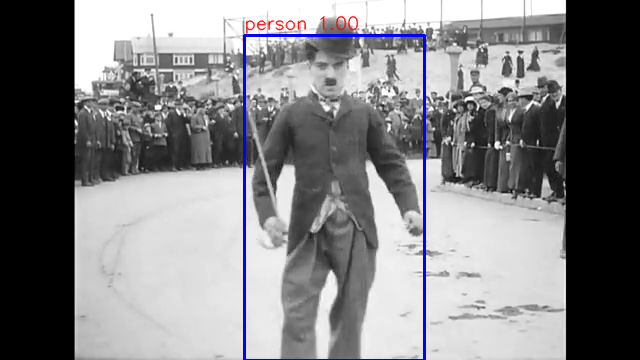

time: 1.55s
class: person, score: 1.00
box coordinate x,y,w,h: [244.11647797  35.18908024 179.90837097 328.02678108]



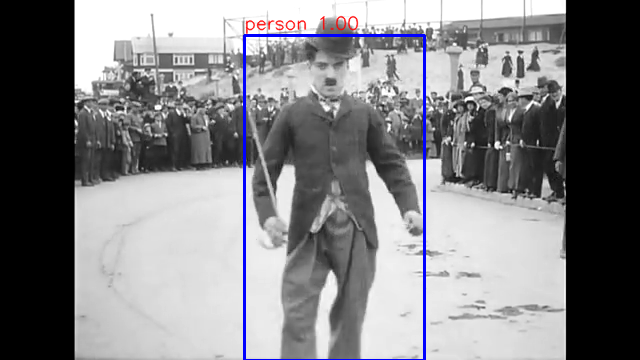

time: 1.50s
class: person, score: 1.00
box coordinate x,y,w,h: [249.25823212  36.92752719 167.45267868 326.29645586]



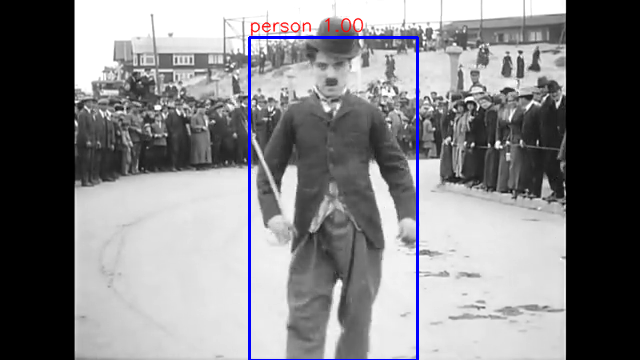

time: 1.57s
class: person, score: 0.99
box coordinate x,y,w,h: [258.37574005  34.44886565 155.17776489 329.73599195]



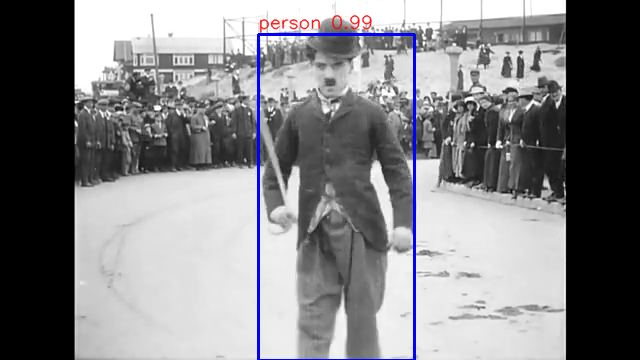

time: 1.24s
class: person, score: 0.99
box coordinate x,y,w,h: [258.00008774  34.02125716 156.24415398 331.21030569]



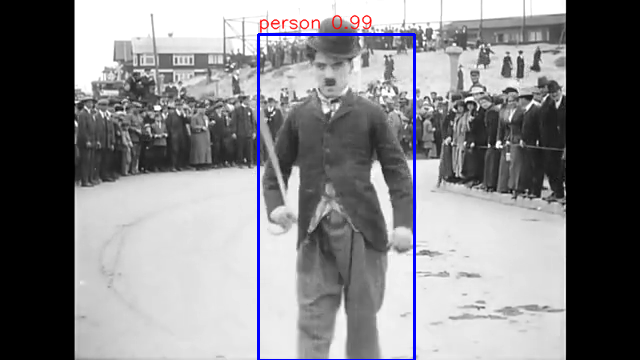

time: 1.51s
class: person, score: 0.97
box coordinate x,y,w,h: [264.96547699  29.7938168  172.38487244 313.80886316]



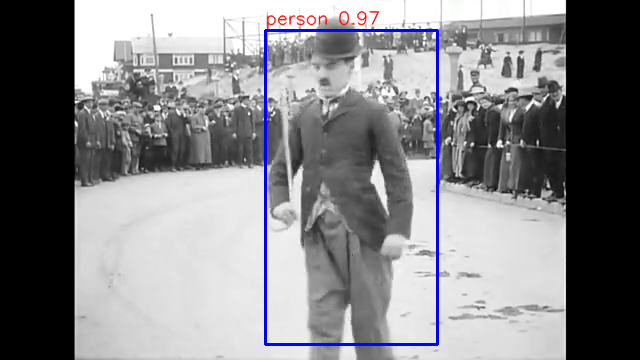

time: 1.51s
class: person, score: 0.98
box coordinate x,y,w,h: [275.20479202  24.09806013 155.56522369 327.2339201 ]



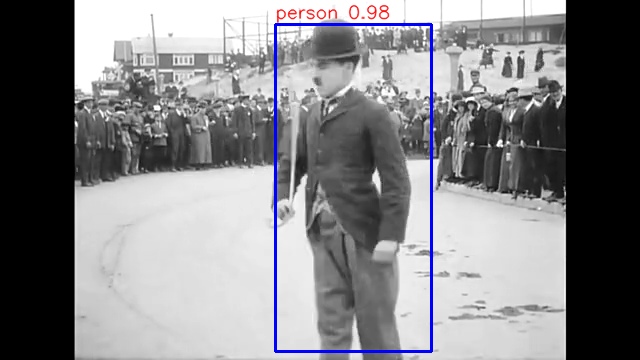

time: 1.50s
class: person, score: 0.98
box coordinate x,y,w,h: [275.11592865  24.11864877 155.80945969 327.28561163]



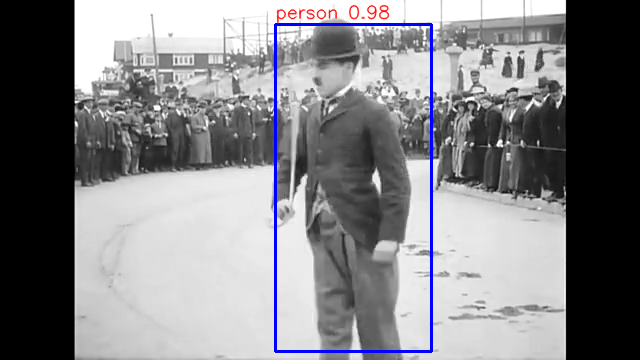

time: 1.50s
class: person, score: 1.00
box coordinate x,y,w,h: [273.08452606  25.87975502 156.04208946 321.81143761]



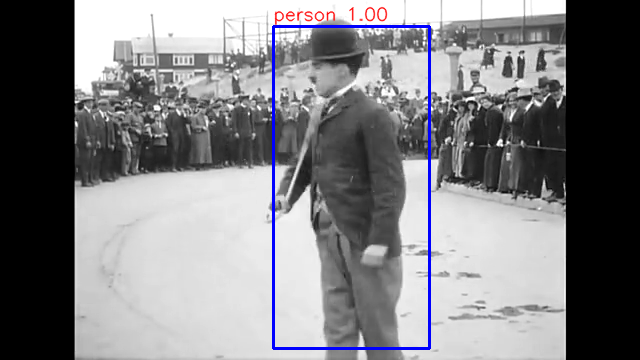

time: 1.44s
class: person, score: 1.00
box coordinate x,y,w,h: [272.84622192  25.65795779 156.57457352 322.1219945 ]



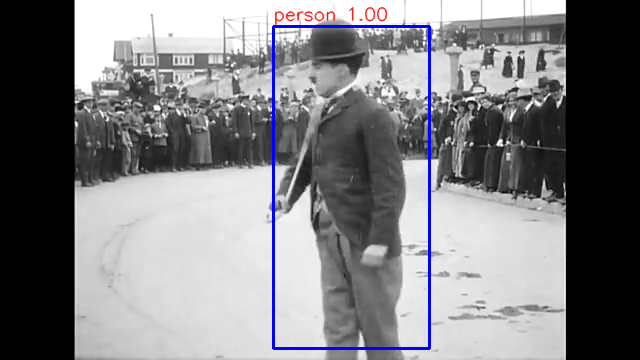

time: 1.46s
class: person, score: 1.00
box coordinate x,y,w,h: [280.01186371  23.12792659 144.88950729 326.9373107 ]



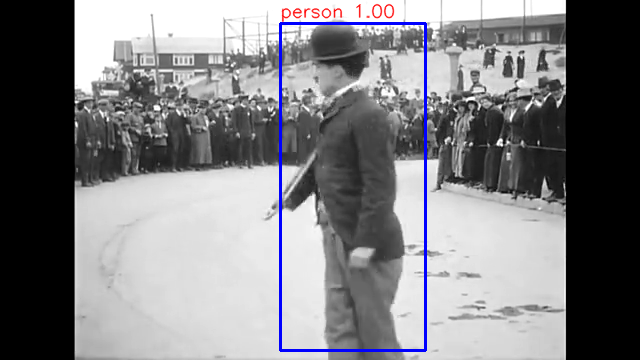

time: 1.51s
class: person, score: 1.00
box coordinate x,y,w,h: [277.50400543  26.86350346 145.9718895  321.63393974]



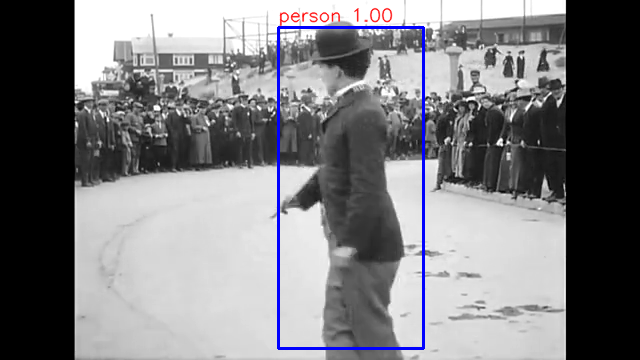

time: 1.53s
class: person, score: 1.00
box coordinate x,y,w,h: [295.40964127  32.19337463 124.93479729 335.29131889]



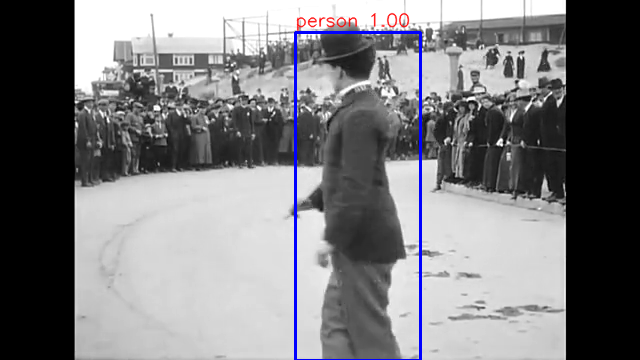

time: 1.50s
class: person, score: 1.00
box coordinate x,y,w,h: [295.49552917  31.47485375 124.88982201 336.52391195]



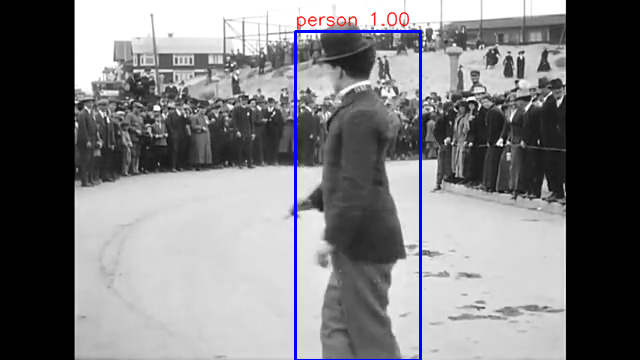

time: 1.46s
class: person, score: 1.00
box coordinate x,y,w,h: [295.56732178  31.76982164 124.84320641 336.08589649]



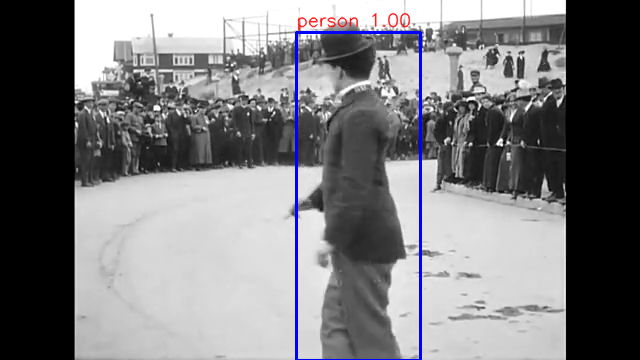

time: 1.50s
class: person, score: 1.00
box coordinate x,y,w,h: [294.23906326  21.10206485 126.6556263  352.40203142]



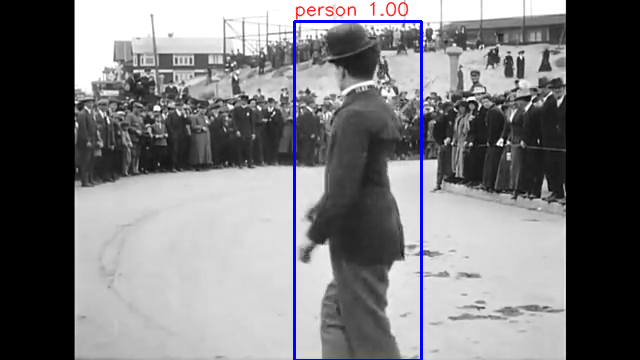

time: 1.54s
class: person, score: 1.00
box coordinate x,y,w,h: [278.14296722  17.73546338 148.98683548 340.13257742]



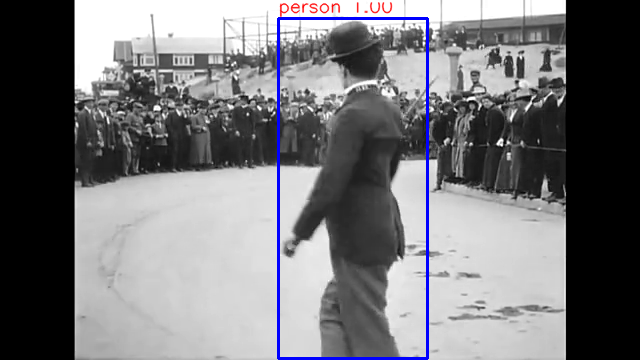

time: 1.55s
class: person, score: 1.00
box coordinate x,y,w,h: [271.69895172  11.51653647 157.45947838 350.40960073]



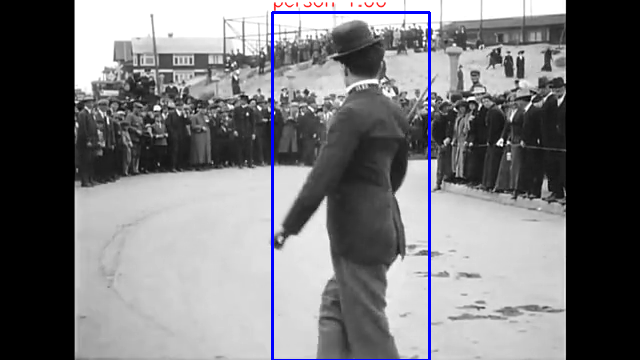

time: 1.57s
class: person, score: 1.00
box coordinate x,y,w,h: [271.7408371   11.3049531  157.45963097 350.79208374]



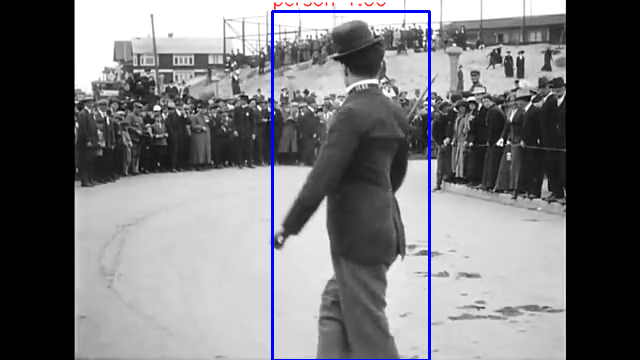

time: 1.60s
class: person, score: 1.00
box coordinate x,y,w,h: [271.74427032  11.37772679 157.45215416 350.6956315 ]



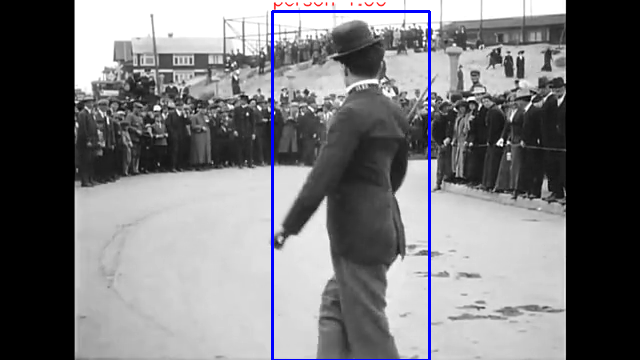

time: 1.57s
class: person, score: 1.00
box coordinate x,y,w,h: [269.38091278  14.57147598 161.0959053  345.86098194]



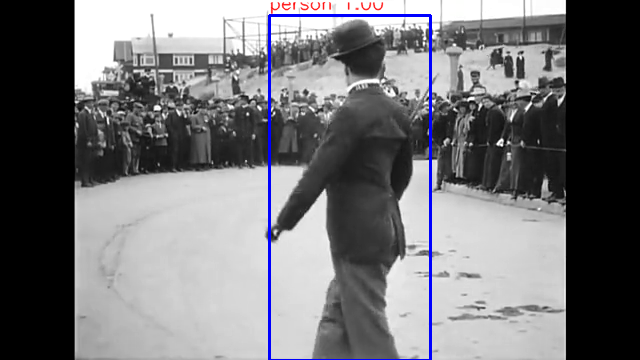

time: 1.55s
class: person, score: 1.00
box coordinate x,y,w,h: [266.70679092  10.85031867 167.09323883 352.30422735]



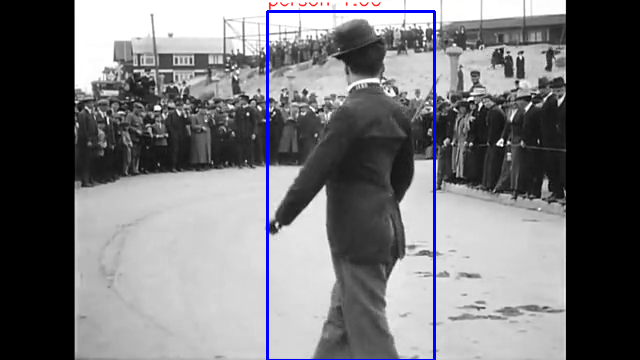

time: 1.48s
class: person, score: 1.00
box coordinate x,y,w,h: [267.08084106  10.45128107 166.58491135 353.39850426]



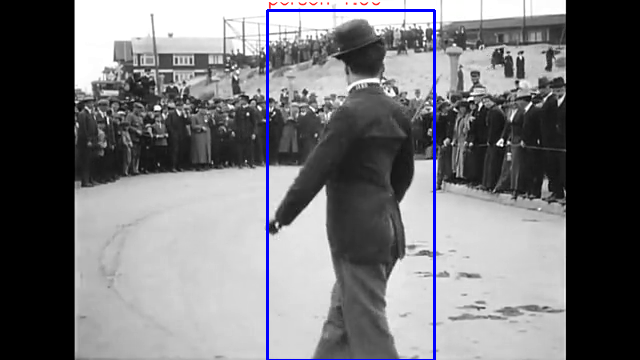

time: 1.48s
class: person, score: 1.00
box coordinate x,y,w,h: [268.9233017   12.82875896 162.21860886 349.93298292]



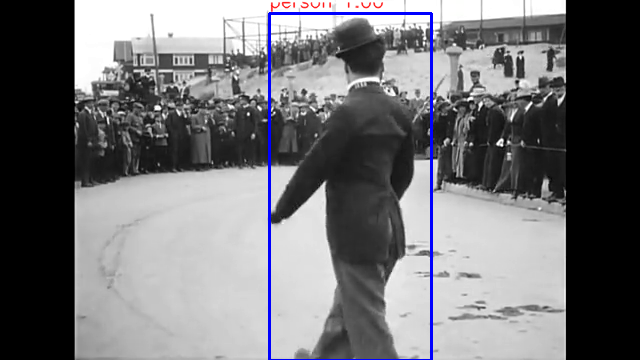

time: 1.35s
class: person, score: 1.00
box coordinate x,y,w,h: [273.93508911  13.97416949 153.1775856  348.58921766]



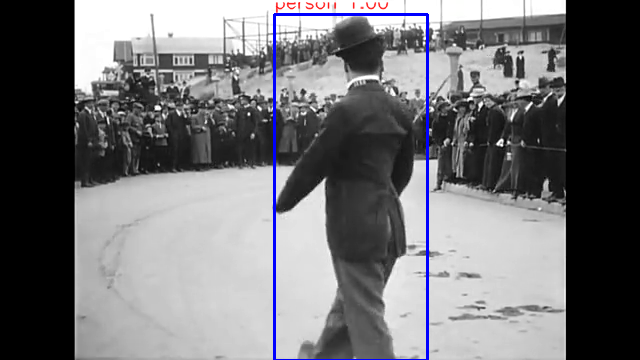

time: 1.38s
class: person, score: 1.00
box coordinate x,y,w,h: [273.96635056  14.37299252 153.14412117 347.80307293]



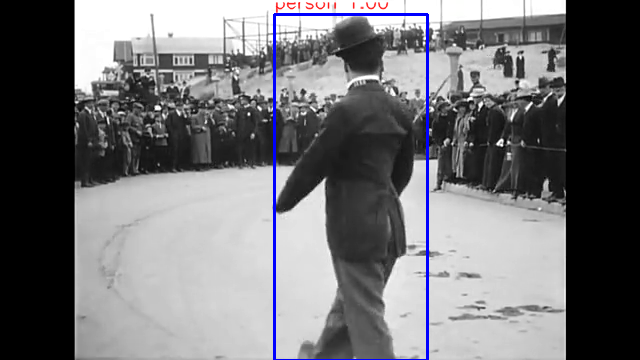

time: 1.35s
class: person, score: 1.00
box coordinate x,y,w,h: [276.8935585    9.59260941 150.3004837  356.73264027]



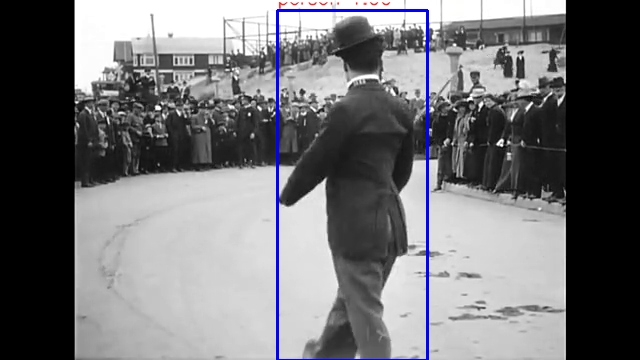

time: 1.53s
class: person, score: 1.00
box coordinate x,y,w,h: [276.97843552  10.24480462 149.44783211 354.44076777]



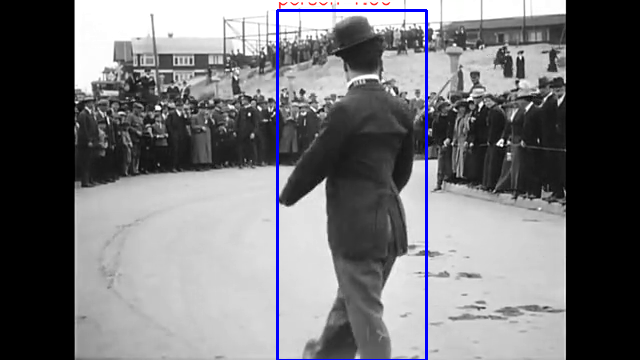

time: 1.44s
class: person, score: 1.00
box coordinate x,y,w,h: [281.71409607   9.53920126 145.90051651 351.65403843]



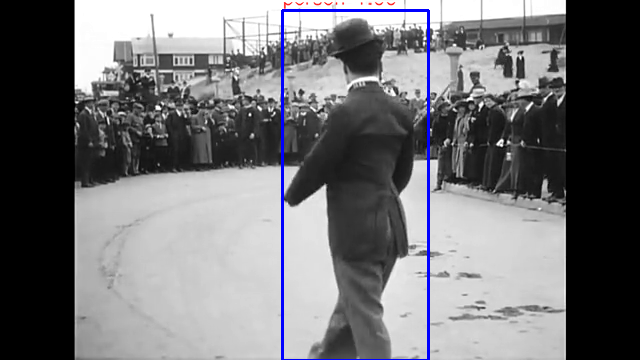

time: 1.24s
class: person, score: 1.00
box coordinate x,y,w,h: [286.2669754   14.38284159 141.99144363 343.24271679]



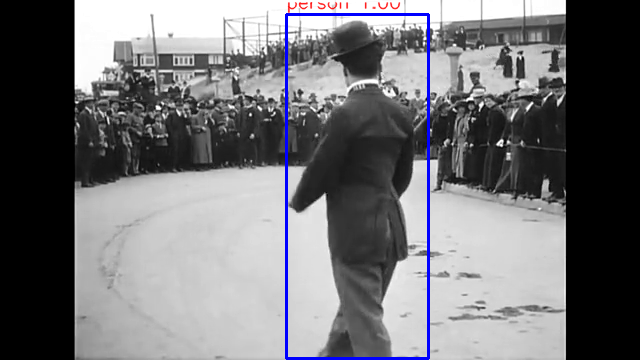

time: 1.48s
class: person, score: 1.00
box coordinate x,y,w,h: [291.46099091  13.97914767 135.45324326 347.3136878 ]



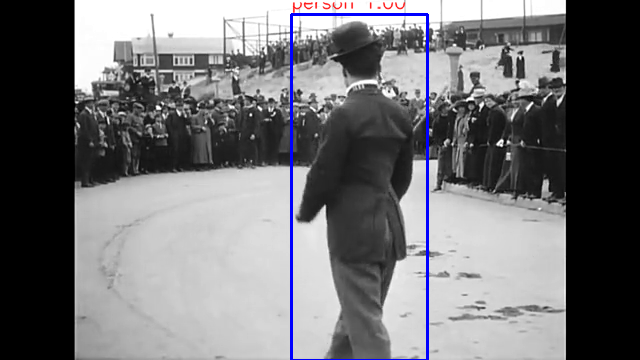

time: 1.47s
class: person, score: 1.00
box coordinate x,y,w,h: [291.58601761  14.13466215 135.04932404 347.04707623]



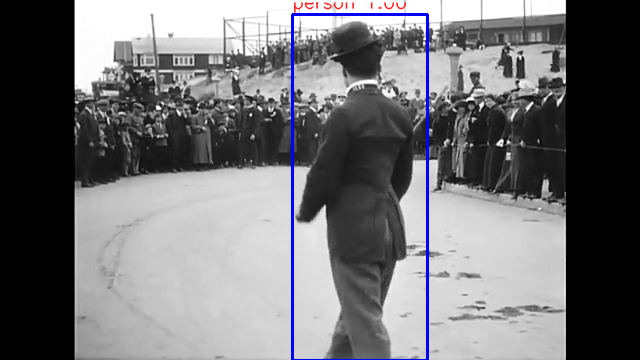

time: 1.45s
class: person, score: 1.00
box coordinate x,y,w,h: [291.47983551  15.07885337 135.16565323 345.40382624]



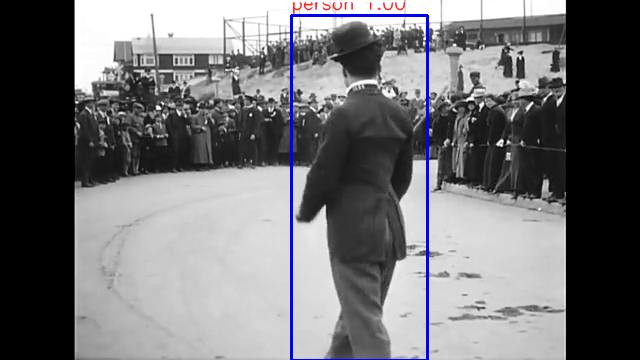

time: 1.51s
class: person, score: 1.00
box coordinate x,y,w,h: [294.58892822  30.51393628 130.11911392 333.57099295]



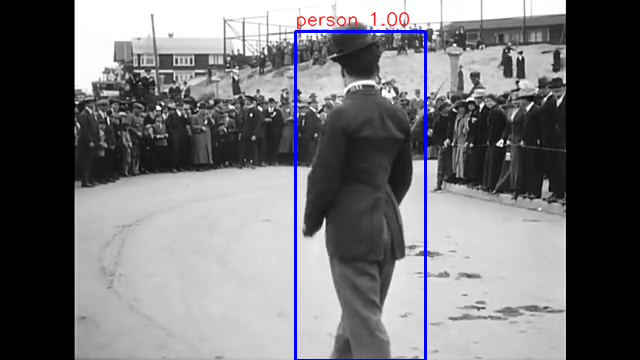

time: 1.45s
class: person, score: 1.00
box coordinate x,y,w,h: [294.68307495  15.1971817  132.54052162 346.83657646]



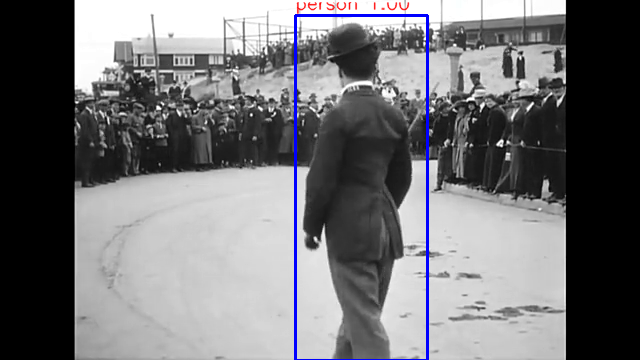

time: 1.44s
class: person, score: 1.00
box coordinate x,y,w,h: [291.11495972  17.97145486 134.40865517 340.60387373]



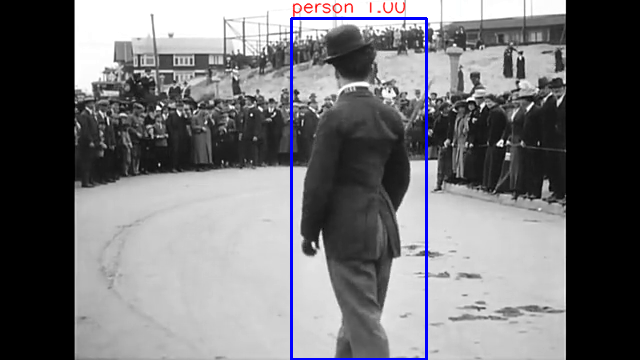

time: 1.42s
class: person, score: 1.00
box coordinate x,y,w,h: [291.03488922  18.10418129 134.88325119 340.07492065]



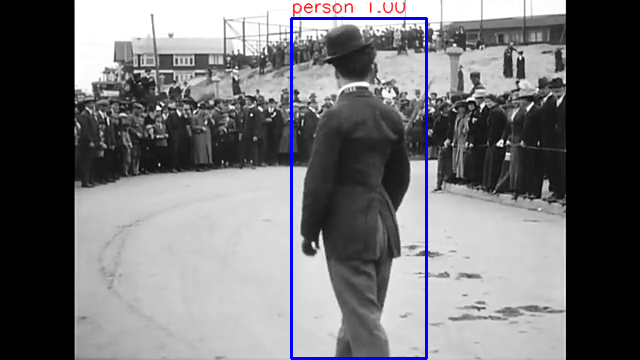

time: 1.42s
class: person, score: 1.00
box coordinate x,y,w,h: [290.82933426  18.04421782 135.05040169 340.03340006]



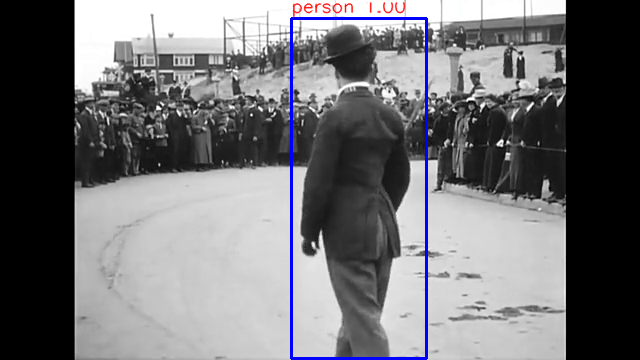

time: 1.45s
class: person, score: 1.00
box coordinate x,y,w,h: [288.57910156  33.0059123  130.40655136 327.42249012]



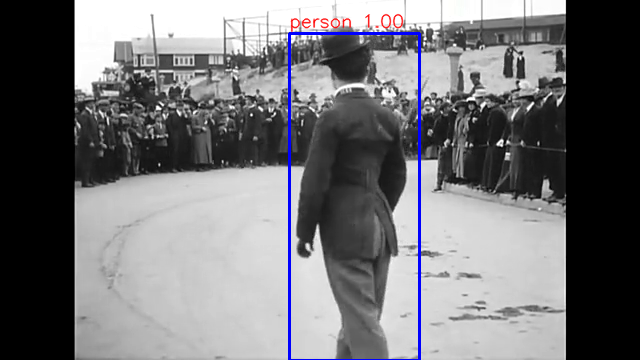

time: 1.48s
class: person, score: 1.00
box coordinate x,y,w,h: [285.23948669  27.56077051 128.539114   337.14951038]



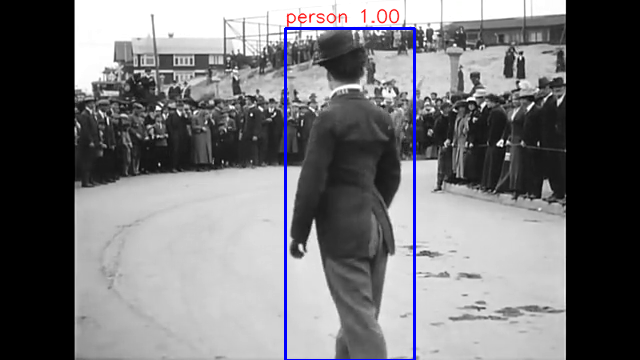

time: 1.51s
class: person, score: 1.00
box coordinate x,y,w,h: [282.45441437  29.95750666 114.19463158 331.24135494]



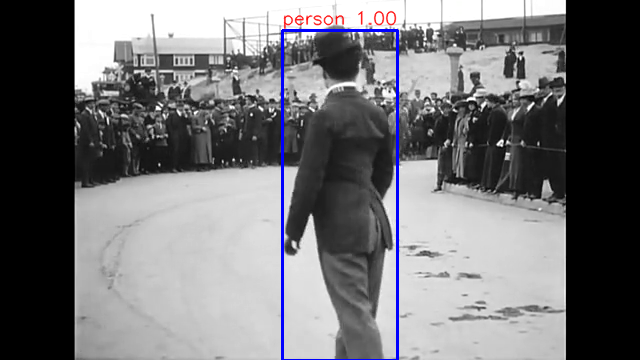

time: 1.52s
class: person, score: 1.00
box coordinate x,y,w,h: [282.22076416  29.96007085 114.74432945 331.30098581]



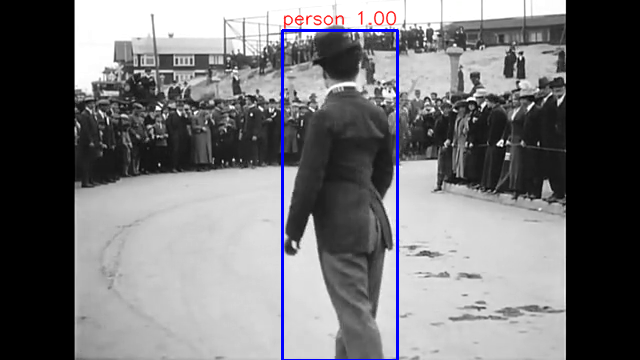

time: 1.47s
class: person, score: 1.00
box coordinate x,y,w,h: [275.02151489  22.2184217  124.78354454 332.40425348]



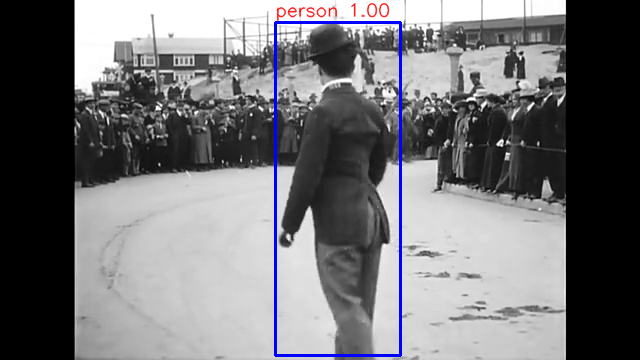

time: 1.33s
class: person, score: 1.00
box coordinate x,y,w,h: [274.98180389  21.30732894 124.76372719 334.04310465]



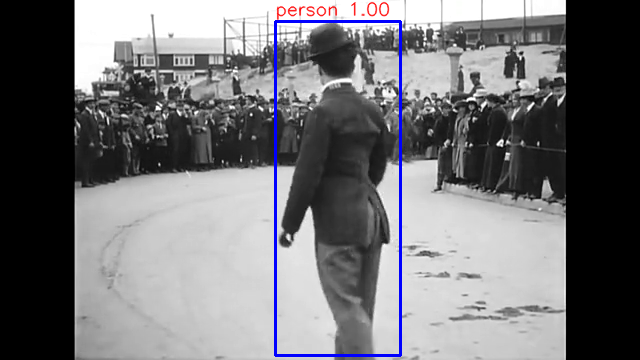

time: 1.48s
class: person, score: 1.00
box coordinate x,y,w,h: [268.52668762  17.2157371  131.53784752 339.15732622]



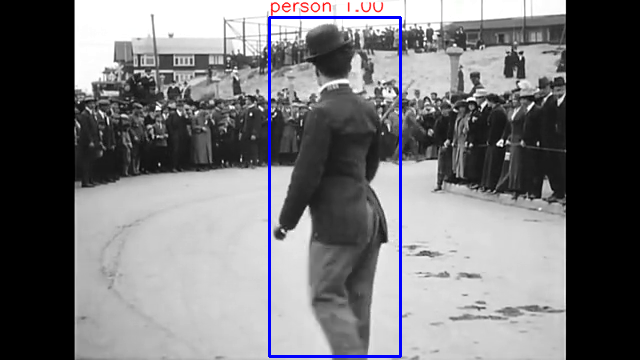

time: 1.46s
class: person, score: 1.00
box coordinate x,y,w,h: [270.35840988  21.82734489 123.06621552 347.88542747]



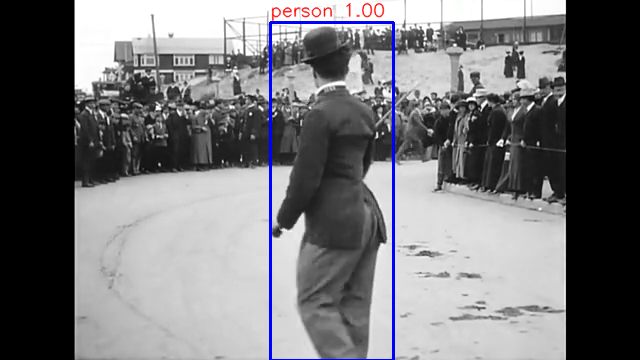

time: 1.50s
class: person, score: 1.00
box coordinate x,y,w,h: [270.57451248  21.78150058 122.74912834 348.05226088]



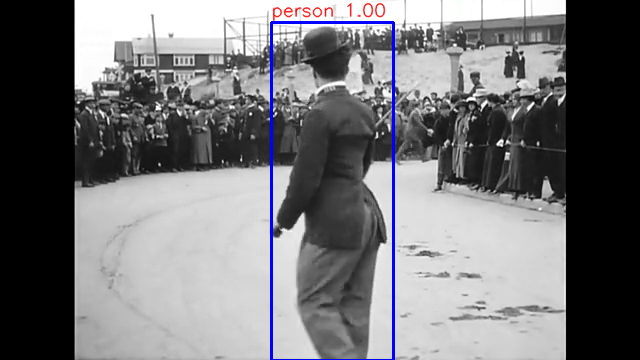

time: 1.49s
class: person, score: 1.00
box coordinate x,y,w,h: [266.85943604  19.0403688  123.53295326 353.91951799]



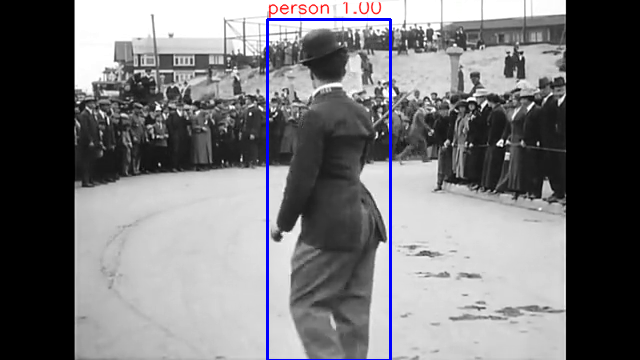

time: 1.47s
class: person, score: 1.00
box coordinate x,y,w,h: [265.08192062  20.01001954 122.59296417 352.52618551]



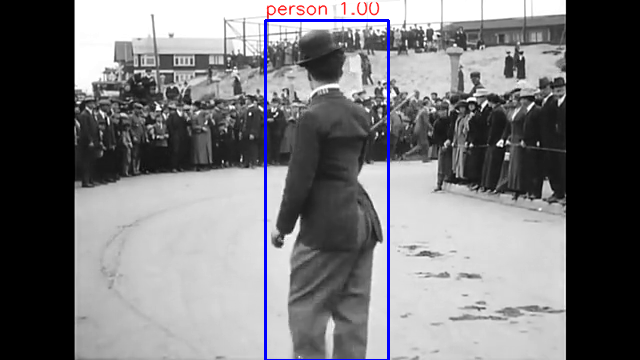

time: 1.39s
class: person, score: 1.00
box coordinate x,y,w,h: [265.19989014  20.70798397 122.80469894 351.30453587]



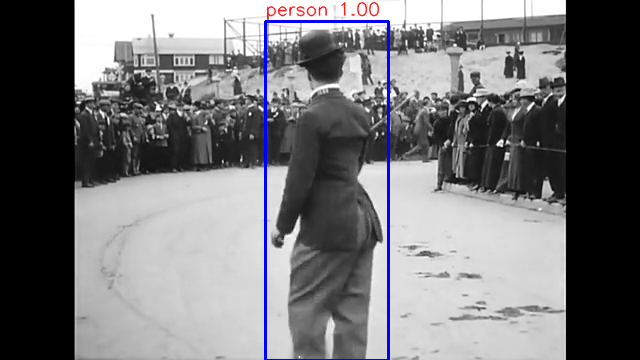

time: 1.44s
class: person, score: 1.00
box coordinate x,y,w,h: [264.91437912  20.73145866 122.89235115 351.22681618]



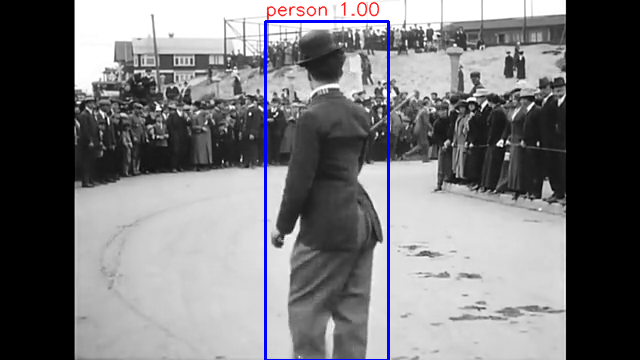

time: 1.40s
class: person, score: 0.99
box coordinate x,y,w,h: [254.58938599  31.04112983 126.6663456  330.01060724]



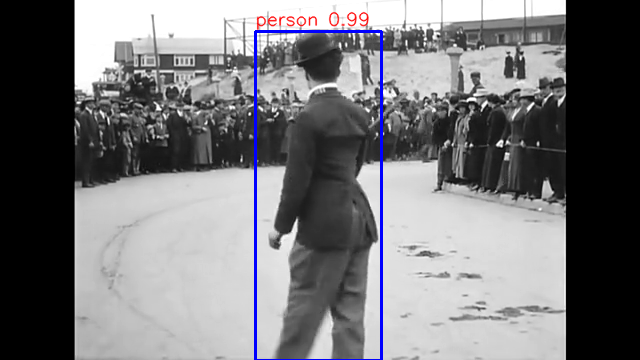

time: 1.49s
class: person, score: 1.00
box coordinate x,y,w,h: [242.98440933  15.43622017 136.6778183  345.02177238]



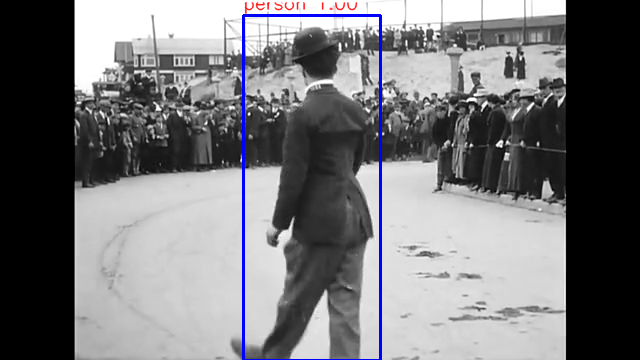

time: 1.44s
class: person, score: 1.00
box coordinate x,y,w,h: [239.79913712  23.57347369 134.47564125 345.08513689]



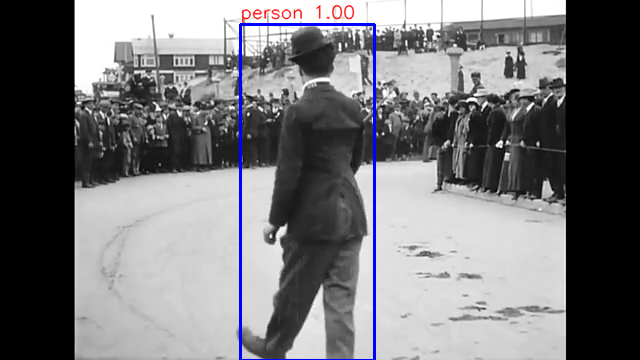

time: 1.39s
class: person, score: 1.00
box coordinate x,y,w,h: [239.21512604  23.53975296 135.07551193 345.05074024]



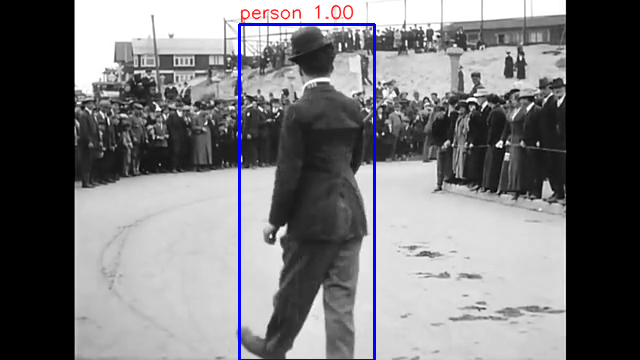

time: 1.23s
class: person, score: 1.00
box coordinate x,y,w,h: [239.16732788  23.69740248 135.0922966  344.72089291]



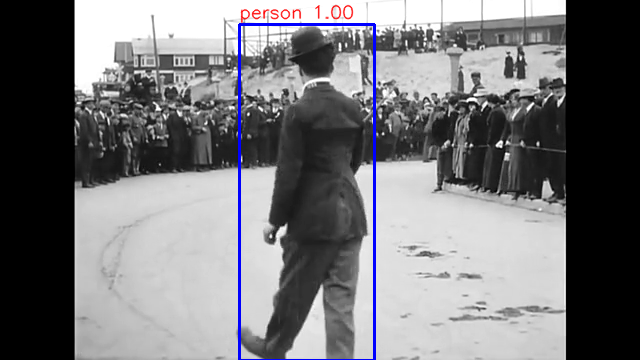

time: 1.41s
class: person, score: 1.00
box coordinate x,y,w,h: [241.66988373  29.91194129 130.86960793 335.6531167 ]



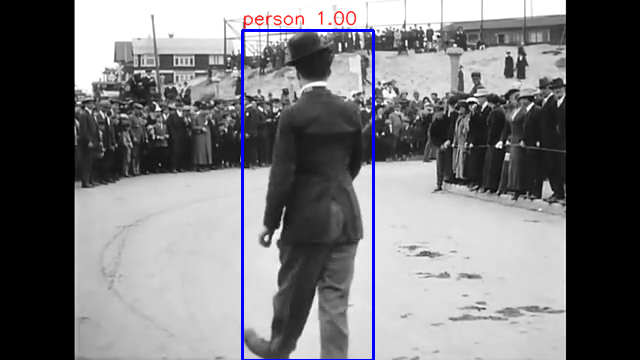

time: 1.37s
class: person, score: 1.00
box coordinate x,y,w,h: [246.26964569  29.98368502 124.47223663 343.3327961 ]



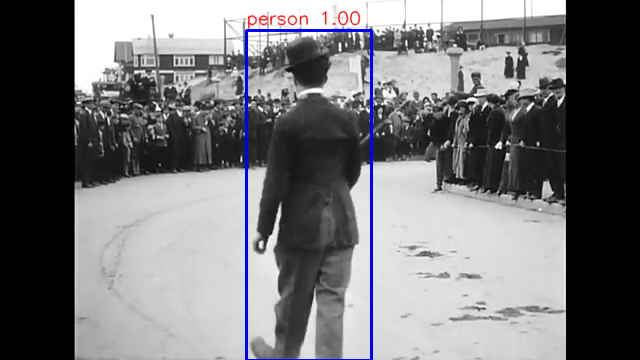

time: 1.29s
class: person, score: 0.99
box coordinate x,y,w,h: [247.05696106  40.21576524 117.14550018 330.43486834]



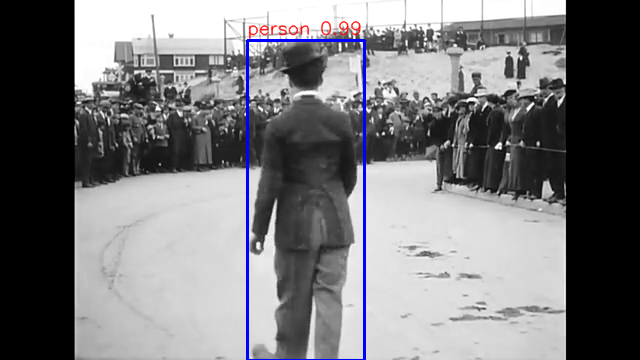

time: 1.45s
class: person, score: 0.99
box coordinate x,y,w,h: [246.88434601  40.40361643 117.82510757 329.23334599]



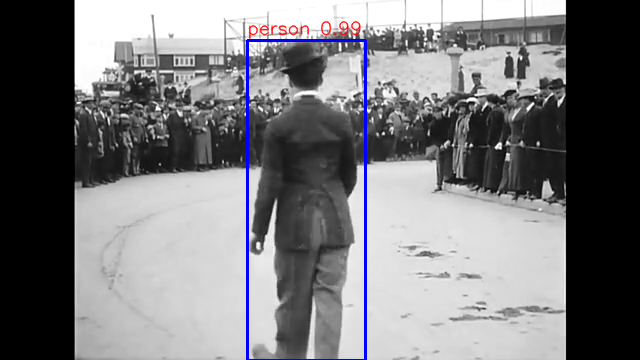

time: 1.43s
class: person, score: 0.98
box coordinate x,y,w,h: [242.68939972  42.87558317 120.79942703 324.53548908]



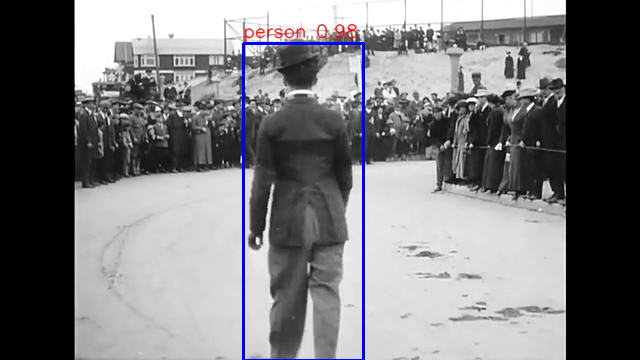

time: 1.45s
class: person, score: 0.98
box coordinate x,y,w,h: [242.64562607  42.9947269  120.87702751 324.4822526 ]



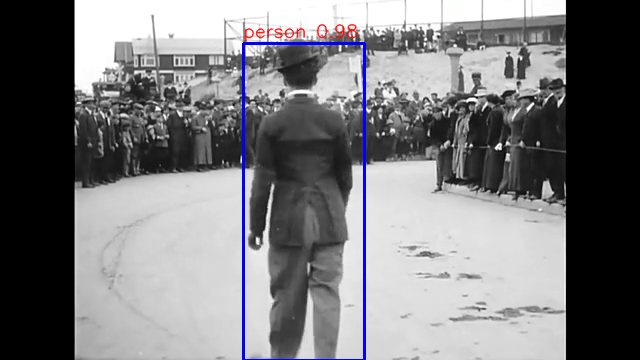

time: 1.46s
class: person, score: 0.99
box coordinate x,y,w,h: [235.02937317  41.64550066 115.06872177 329.94659901]



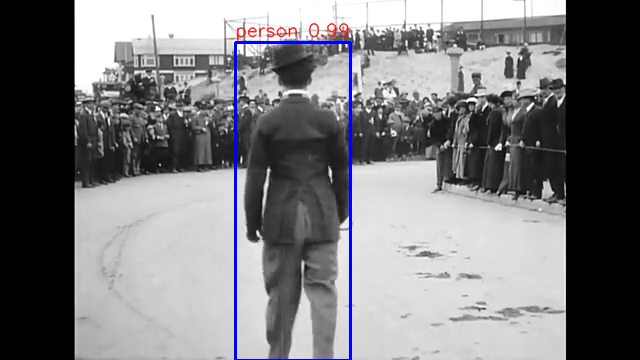

time: 1.44s
class: person, score: 1.00
box coordinate x,y,w,h: [233.02448273  32.57404447 118.15459251 336.01957083]



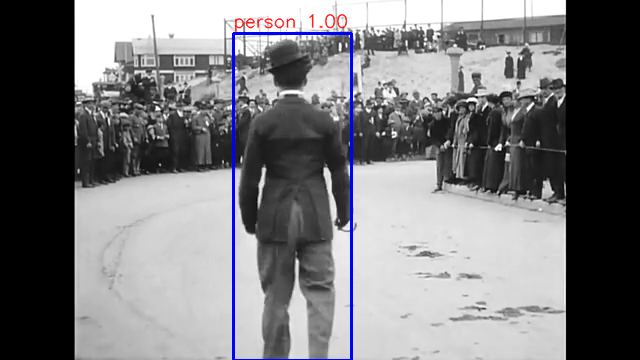

time: 1.45s
class: person, score: 1.00
box coordinate x,y,w,h: [233.13199997  31.17128134 118.06508064 338.09356213]



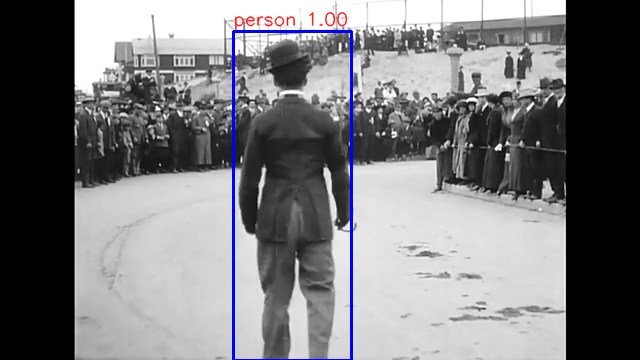

time: 1.32s
class: person, score: 1.00
box coordinate x,y,w,h: [230.04236221  32.87363648 123.24183464 332.24611044]



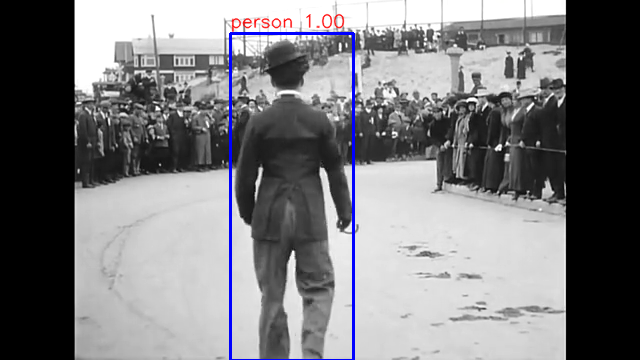

time: 1.42s
class: person, score: 1.00
box coordinate x,y,w,h: [229.94886398  25.93818426 121.71733856 350.42871952]



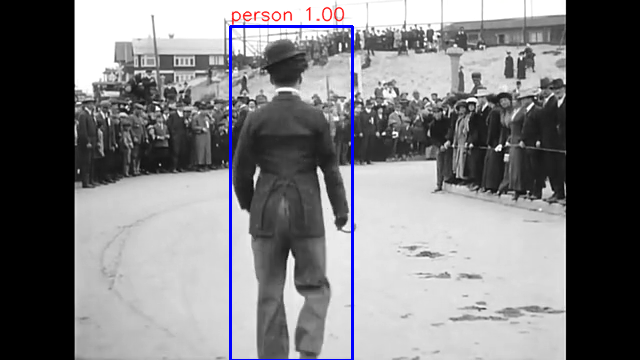

time: 1.42s
class: person, score: 1.00
box coordinate x,y,w,h: [229.90982056  26.03091359 121.79470062 350.12653112]



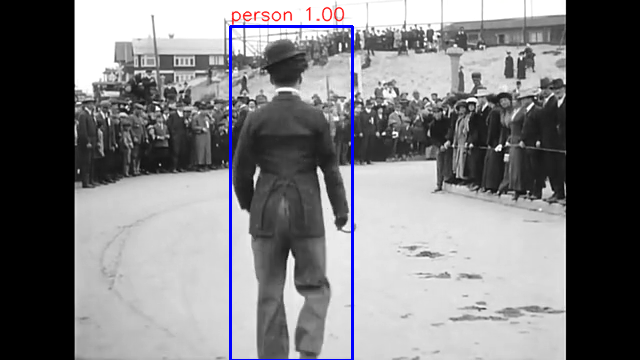

time: 1.41s
class: person, score: 1.00
box coordinate x,y,w,h: [230.92254639  26.00631237 118.53471756 344.00862694]



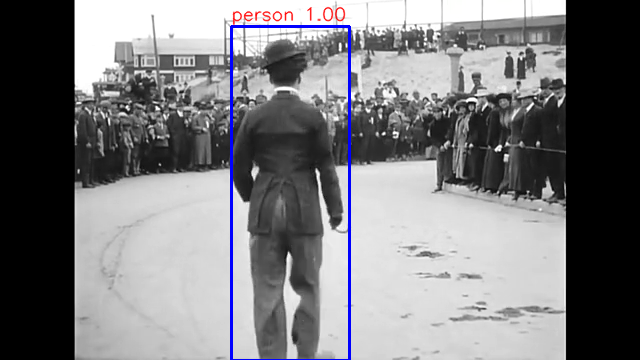

time: 1.44s
class: person, score: 1.00
box coordinate x,y,w,h: [230.59890747  26.08909607 118.94132614 343.55247974]



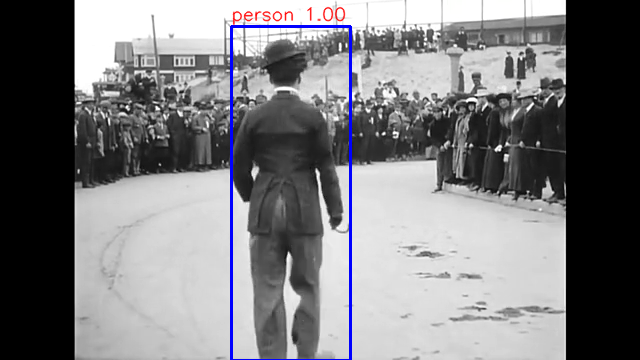

time: 1.37s
class: person, score: 1.00
box coordinate x,y,w,h: [230.02086639  29.14694309 118.7216568  341.26311779]



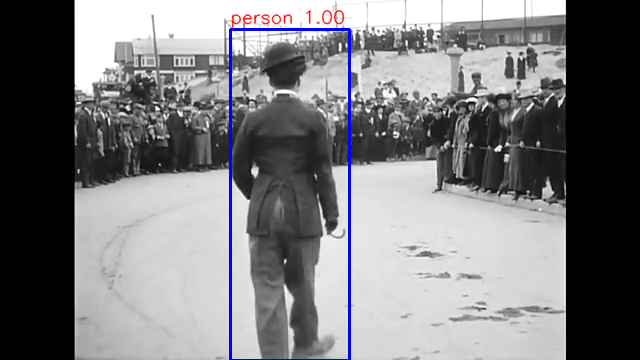

time: 1.50s
class: person, score: 1.00
box coordinate x,y,w,h: [230.40187836  31.15892172 114.84739304 336.85103416]



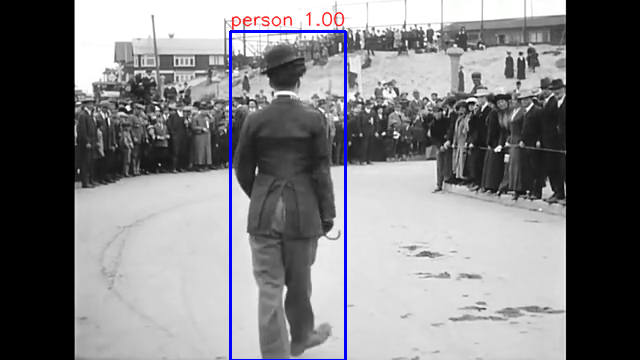

time: 1.60s
class: person, score: 1.00
box coordinate x,y,w,h: [230.77177048  40.82311392 115.56036949 322.30886936]



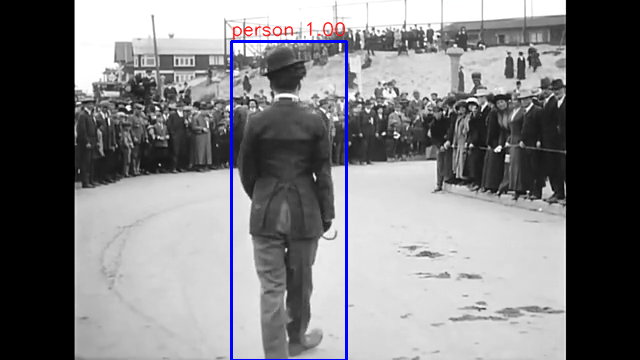

time: 1.59s
class: person, score: 1.00
box coordinate x,y,w,h: [230.68384171  41.70004606 115.92946053 321.11320496]



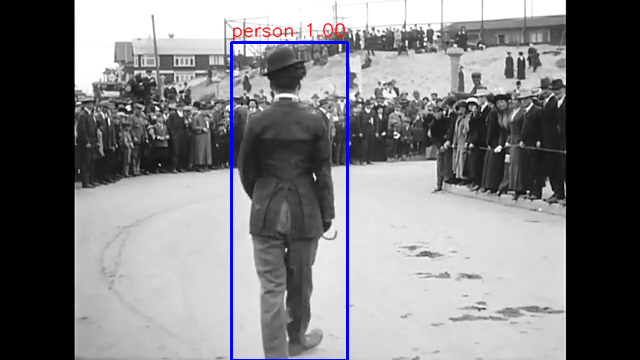

time: 1.60s
class: person, score: 1.00
box coordinate x,y,w,h: [230.55683136  41.37333155 115.98218918 321.76543236]



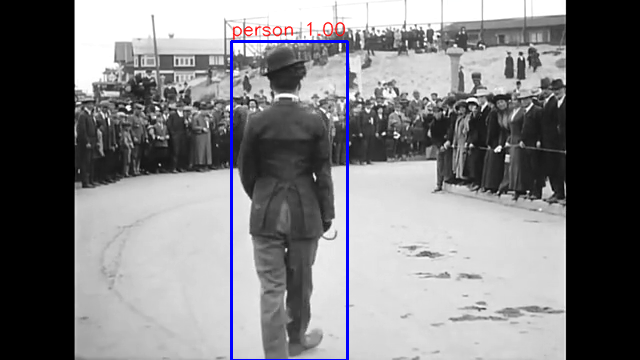

time: 1.63s
class: person, score: 1.00
box coordinate x,y,w,h: [235.53670883  41.10823274 109.1223526  317.68338919]



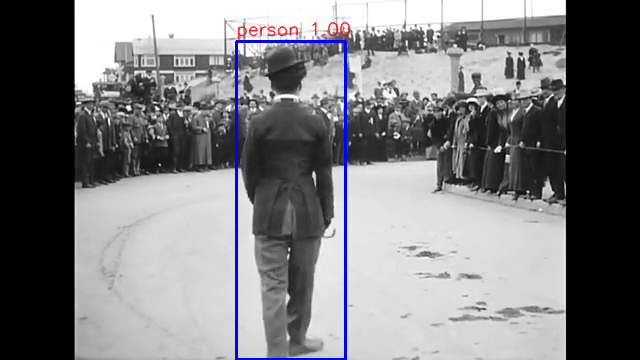

time: 1.33s
class: person, score: 1.00
box coordinate x,y,w,h: [236.40720367  36.37447715 105.80037117 324.39740896]



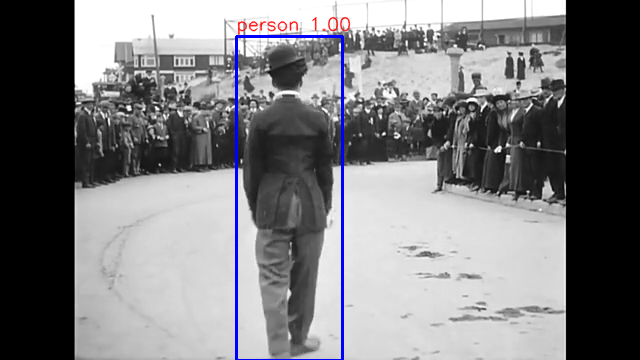

time: 1.44s
class: person, score: 1.00
box coordinate x,y,w,h: [231.38679504  37.299335   112.18854904 325.85419178]



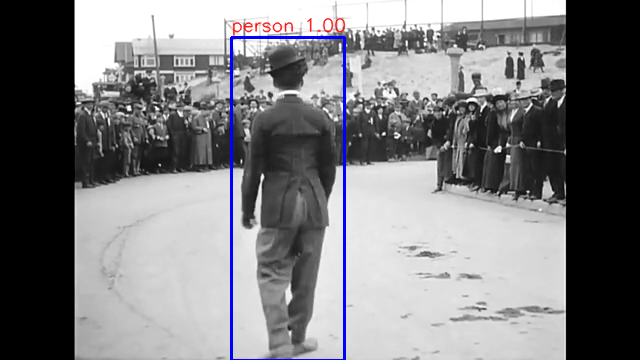

time: 1.50s
class: person, score: 1.00
box coordinate x,y,w,h: [231.1333847   36.36510015 112.29393959 327.24690199]



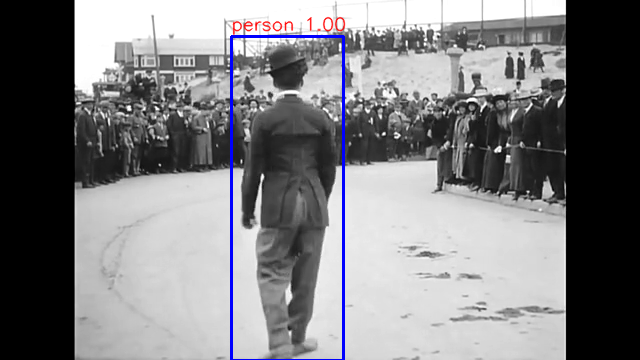

time: 1.45s
class: person, score: 1.00
box coordinate x,y,w,h: [231.00969315  36.34768724 112.40146637 327.1293354 ]



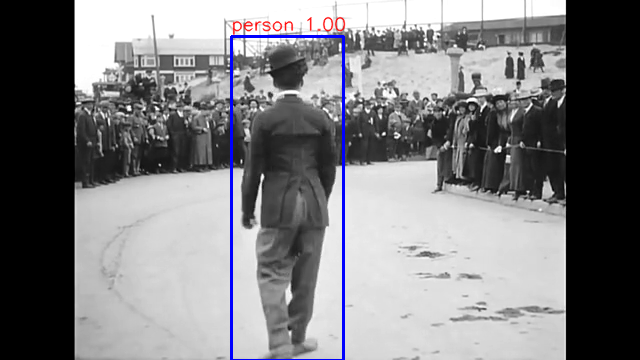

time: 1.52s
class: person, score: 1.00
box coordinate x,y,w,h: [224.86412048  42.78787494 119.56154823 320.18453836]



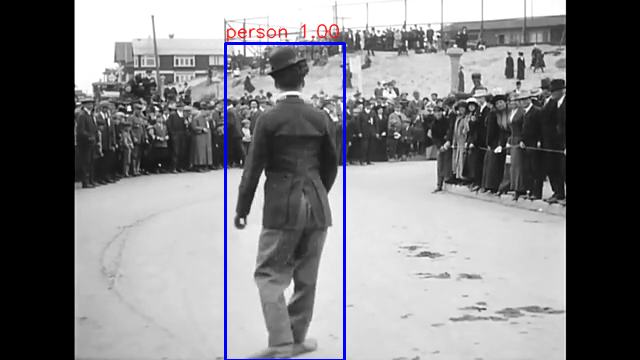

time: 1.47s
class: person, score: 1.00
box coordinate x,y,w,h: [225.92813492  40.38829565 119.64396477 321.81229591]



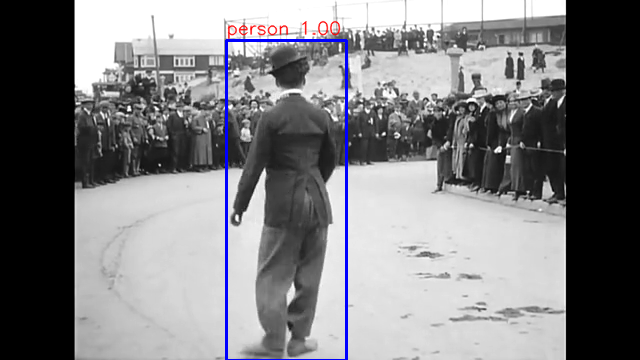

time: 1.49s
class: person, score: 1.00
box coordinate x,y,w,h: [225.76641083  40.25529027 119.7723484  322.28704691]



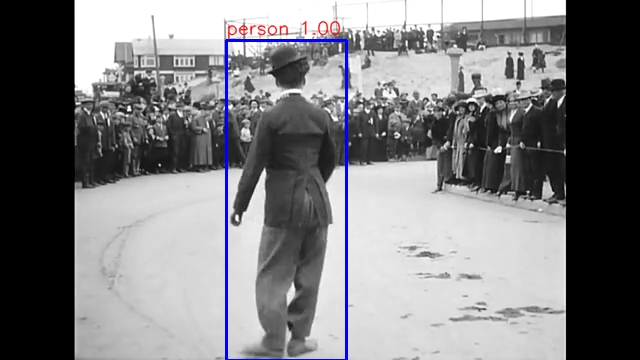

time: 1.45s
class: person, score: 1.00
box coordinate x,y,w,h: [228.23970795  37.39560485 114.84852791 319.50956583]



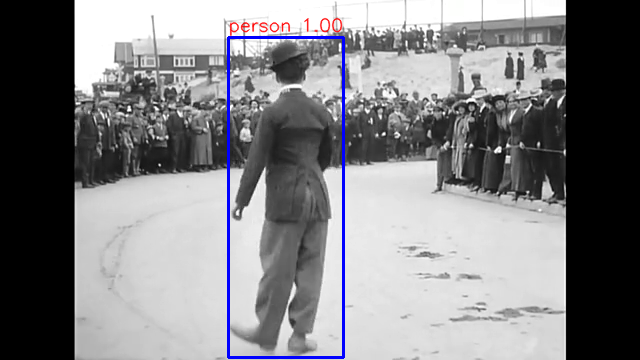

time: 1.42s
class: person, score: 1.00
box coordinate x,y,w,h: [230.09180069  33.54132414 111.924963   324.7928524 ]



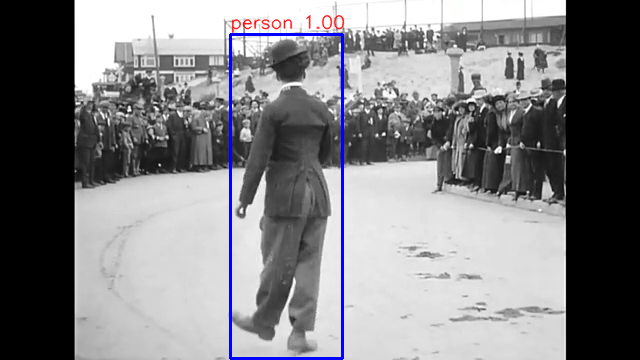

time: 1.49s
class: person, score: 1.00
box coordinate x,y,w,h: [229.98275757  33.74539733 112.15219498 324.37659502]



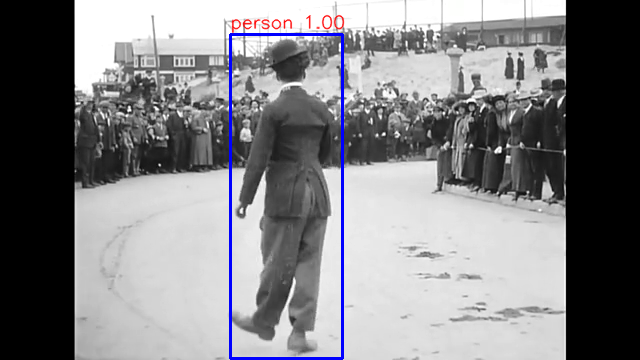

time: 1.49s
class: person, score: 1.00
box coordinate x,y,w,h: [223.70128632  35.45378208 119.63785172 323.31609249]



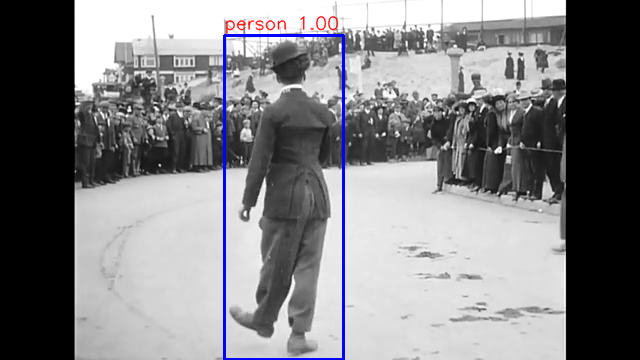

time: 1.48s
class: person, score: 1.00
box coordinate x,y,w,h: [223.48991394  35.73367596 119.89076614 322.92393208]



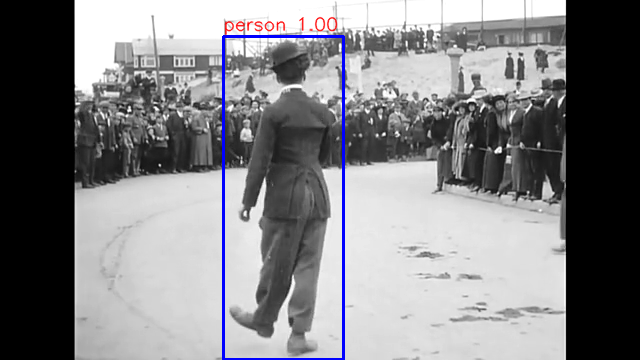

time: 1.43s
class: person, score: 1.00
box coordinate x,y,w,h: [227.33123779  38.51634979 119.05518532 319.83304024]



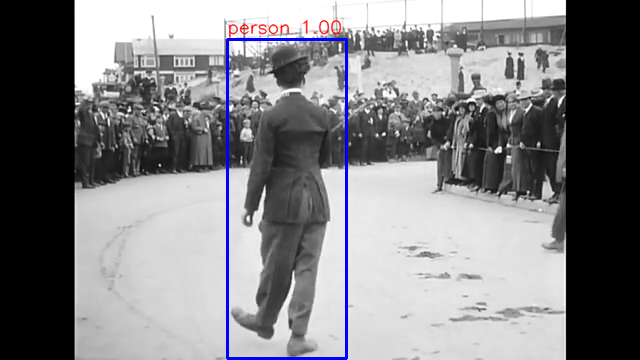

time: 1.52s
class: person, score: 1.00
box coordinate x,y,w,h: [234.07794952  35.11725068 110.75013161 324.79205847]



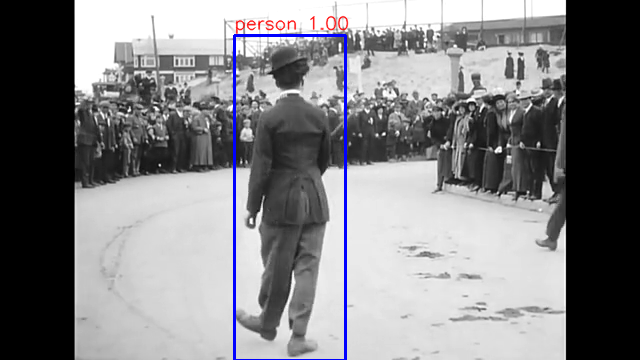

time: 1.54s
class: person, score: 0.99
box coordinate x,y,w,h: [235.76324463  39.79643941 105.52861214 315.91531992]



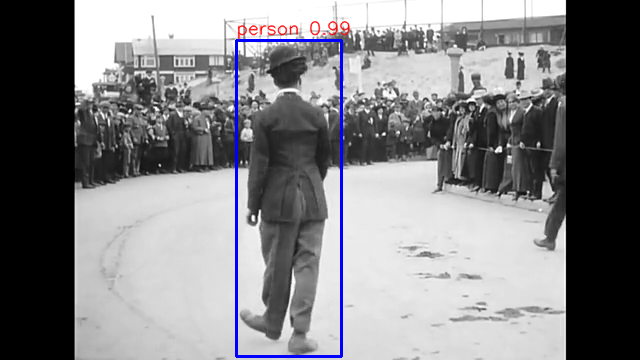

time: 1.42s
class: person, score: 0.99
box coordinate x,y,w,h: [235.86963654  39.67052579 105.52659988 316.02702856]



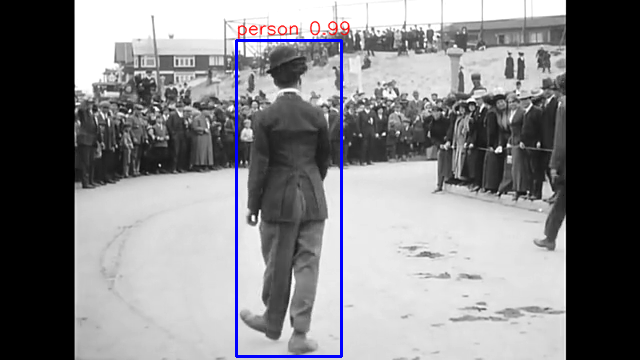

time: 1.40s
class: person, score: 0.99
box coordinate x,y,w,h: [235.69213867  41.05719566 105.52846909 313.53929043]



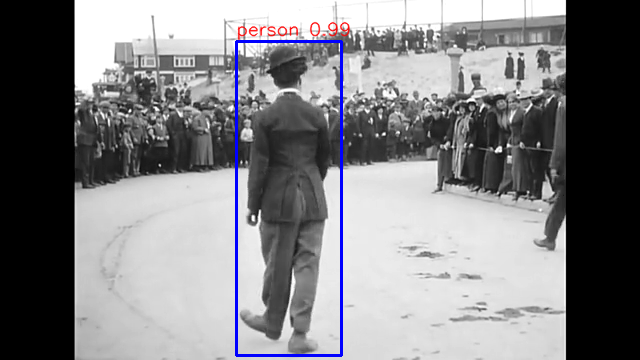

time: 1.44s
class: person, score: 0.99
box coordinate x,y,w,h: [237.58552551  43.74615312 103.91282082 308.02516222]



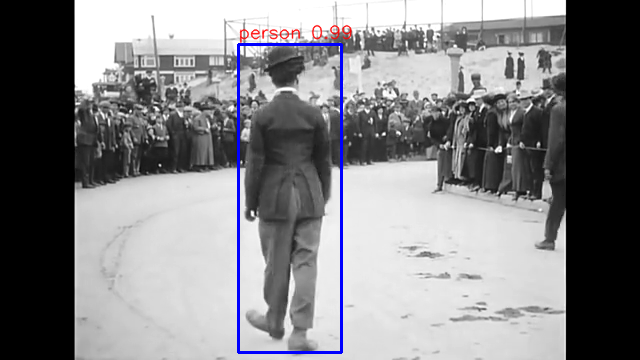

time: 1.41s
class: person, score: 1.00
box coordinate x,y,w,h: [236.05014801  49.76173639 108.8984108  300.66018105]



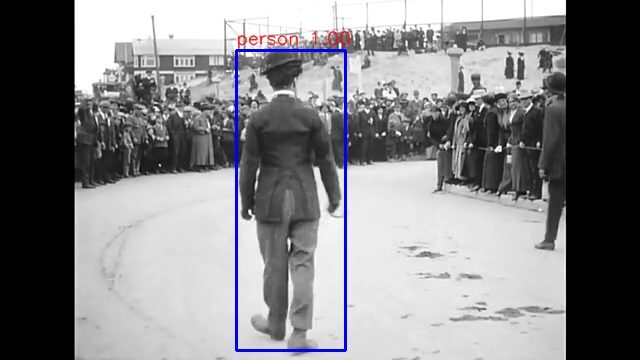

time: 1.42s
class: person, score: 1.00
box coordinate x,y,w,h: [233.28630447  44.70998883 117.38407135 312.55955458]



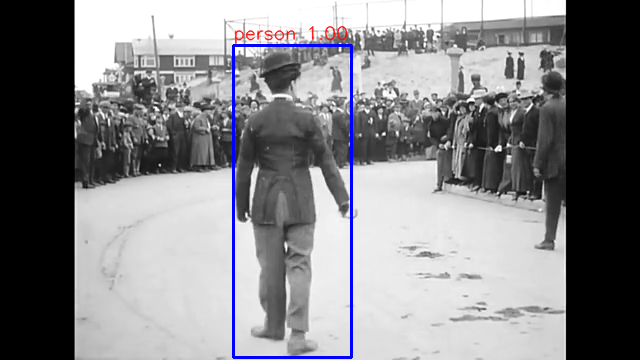

time: 1.48s
class: person, score: 1.00
box coordinate x,y,w,h: [233.12759399  44.47515607 117.67896652 313.08333635]



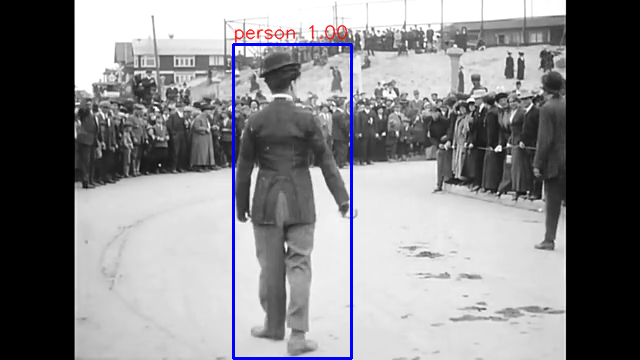

time: 1.52s
class: person, score: 1.00
box coordinate x,y,w,h: [233.07184219  44.78084207 117.7793026  312.46574163]



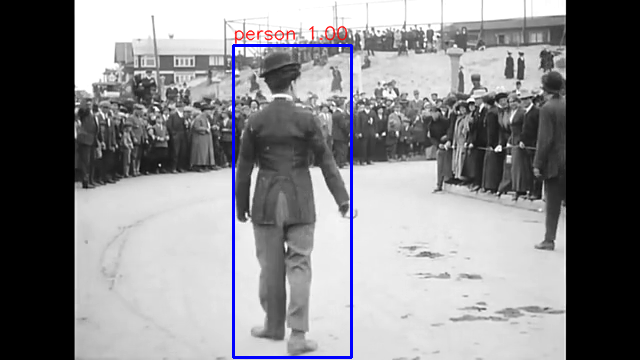

time: 1.44s
class: person, score: 1.00
box coordinate x,y,w,h: [228.57299805  48.85546088 124.98433113 304.89989519]



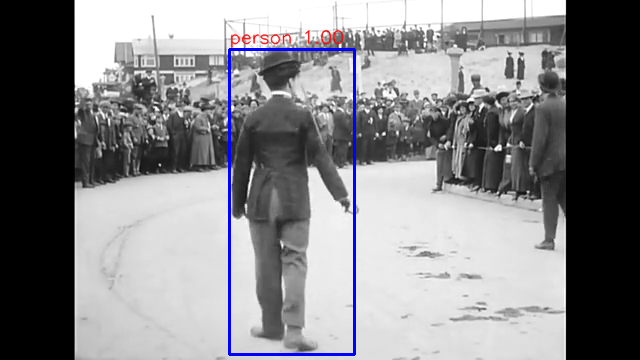

time: 1.50s
class: person, score: 1.00
box coordinate x,y,w,h: [228.70616913  38.99974823 122.03490257 321.03874683]



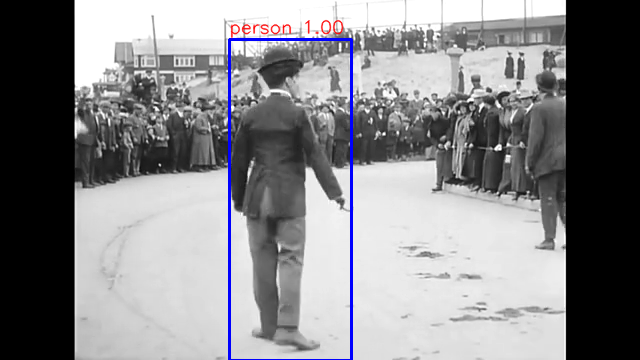

time: 1.46s
class: person, score: 1.00
box coordinate x,y,w,h: [229.35304642  40.78224778 117.87186623 317.01747179]
class: person, score: 0.72
box coordinate x,y,w,h: [517.77053833  75.1833272   64.55205917 169.59871531]



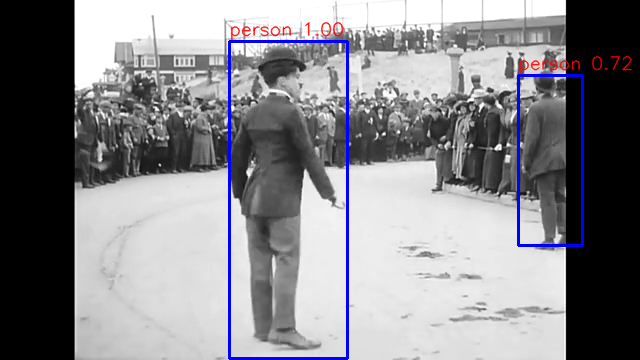

time: 1.37s
class: person, score: 1.00
box coordinate x,y,w,h: [229.34333801  40.57970881 117.9955101  317.22608328]
class: person, score: 0.71
box coordinate x,y,w,h: [518.007164    75.28029442  64.13665771 169.30090427]



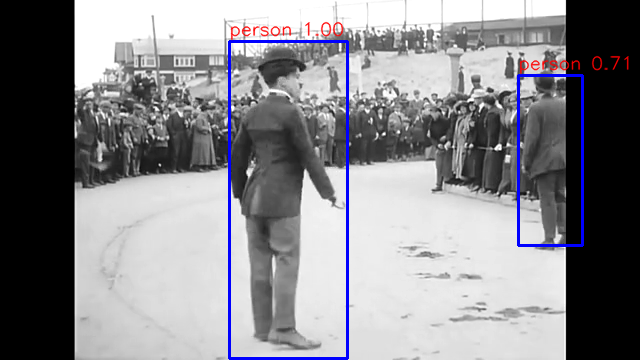

time: 1.43s
class: person, score: 1.00
box coordinate x,y,w,h: [234.99526978  37.33528733 103.50755692 321.58413649]
class: person, score: 0.72
box coordinate x,y,w,h: [516.22123718  72.58064568  65.12949467 174.43382621]



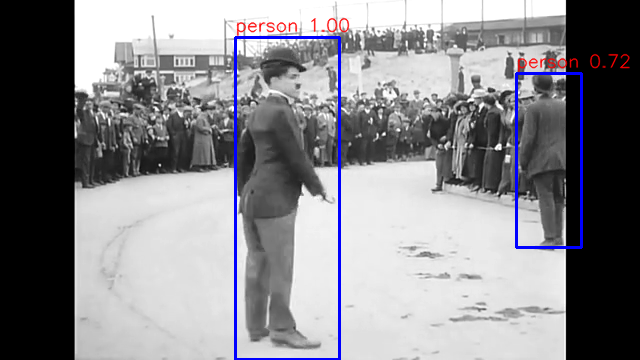

time: 1.41s
class: person, score: 1.00
box coordinate x,y,w,h: [234.99385834  37.41262078 103.59073639 321.50800467]
class: person, score: 0.72
box coordinate x,y,w,h: [516.22509003  72.62669384  65.0972414  174.30615306]



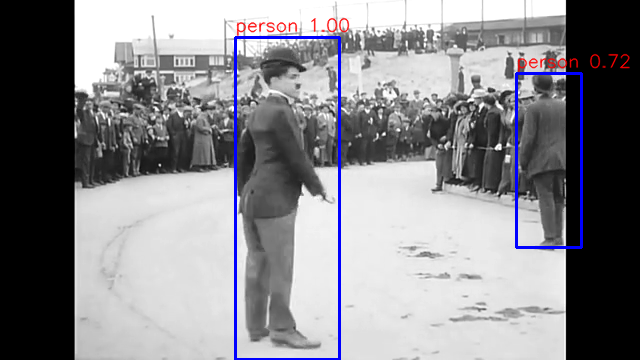

time: 1.51s
class: person, score: 1.00
box coordinate x,y,w,h: [227.75657654  35.81672788 106.19362831 325.60397387]



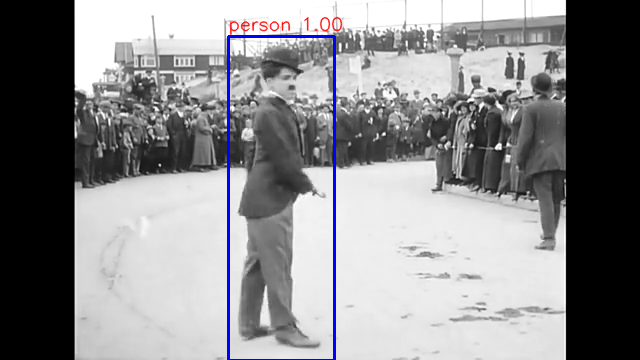

time: 1.44s
class: person, score: 0.99
box coordinate x,y,w,h: [222.38555908  42.57901669 107.59314537 315.00879765]



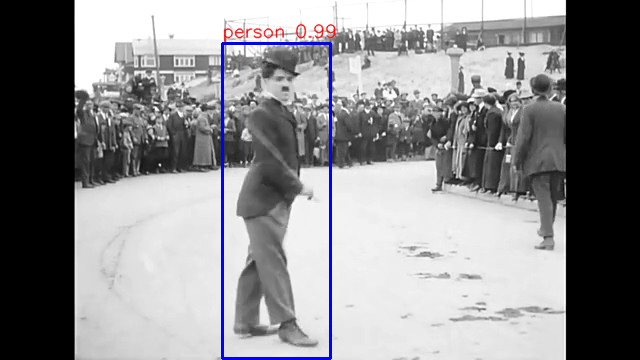

time: 1.50s
class: person, score: 0.99
box coordinate x,y,w,h: [222.19898224  42.60558128 107.46071815 314.85314369]



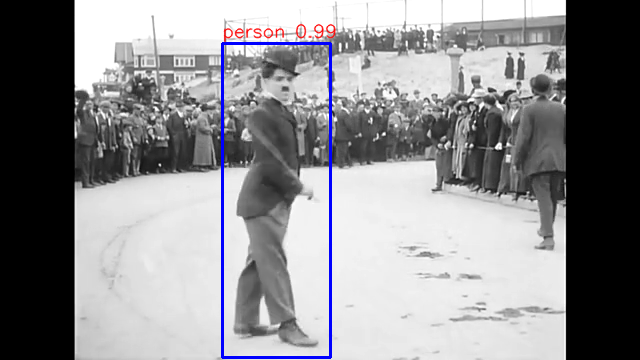

time: 1.48s
class: person, score: 1.00
box coordinate x,y,w,h: [220.69158554  42.07441807 104.9539566  313.65344524]



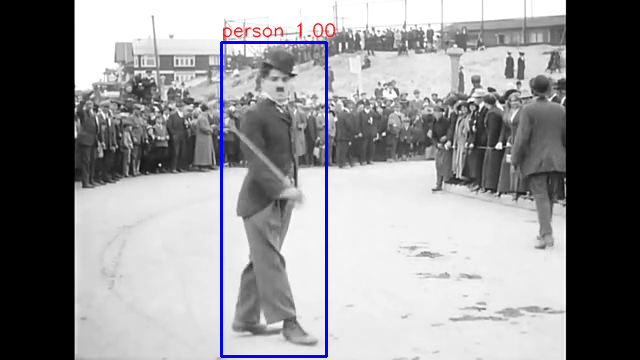

time: 1.47s
class: person, score: 1.00
box coordinate x,y,w,h: [224.57569122  40.32552123 111.00294113 316.29979849]



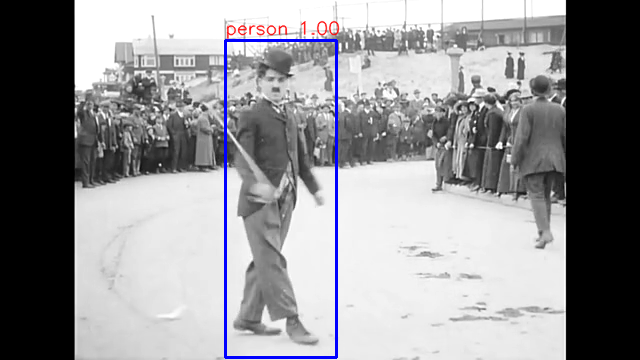

time: 1.45s
class: person, score: 1.00
box coordinate x,y,w,h: [224.63890076  40.50548673 111.2304306  315.9896493 ]



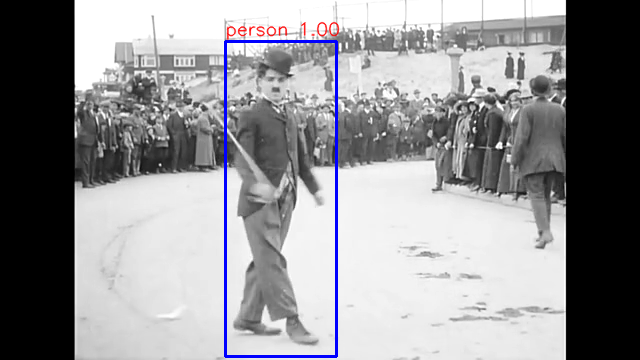

time: 1.41s
class: person, score: 1.00
box coordinate x,y,w,h: [224.53193665  40.44534087 111.1451149  316.11633539]



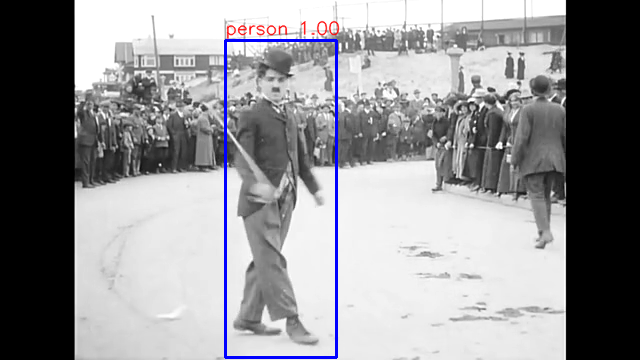

time: 1.46s
class: person, score: 1.00
box coordinate x,y,w,h: [226.73065186  38.72049809 109.59412575 317.07336903]



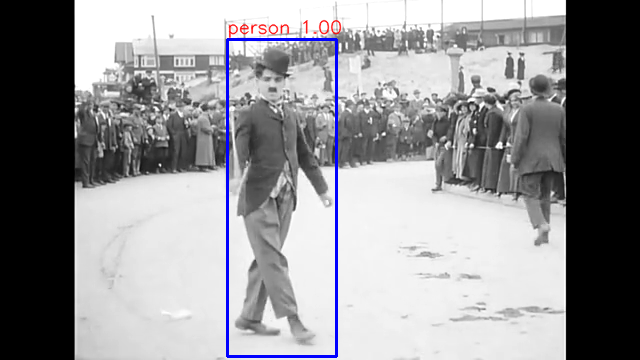

time: 1.47s
class: person, score: 1.00
box coordinate x,y,w,h: [224.08985138  39.68126535 110.72637558 315.54253578]



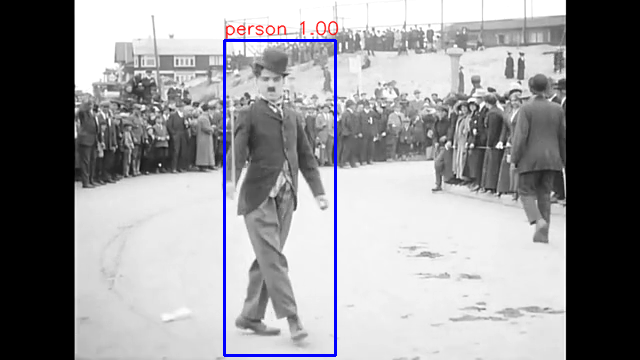

time: 1.44s
class: person, score: 0.99
box coordinate x,y,w,h: [225.38764954  40.2894187  100.47851562 316.29085064]



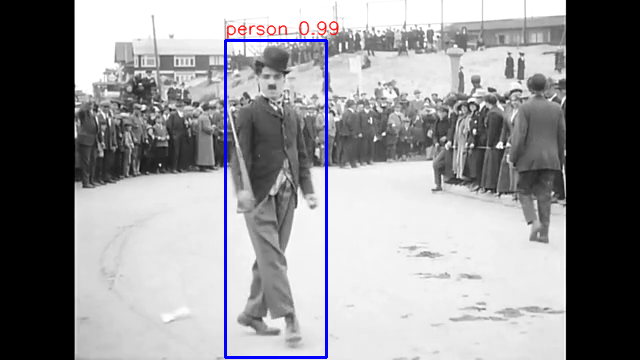

time: 1.41s
class: person, score: 0.99
box coordinate x,y,w,h: [225.25518417  40.54322004 100.58665276 315.81011295]



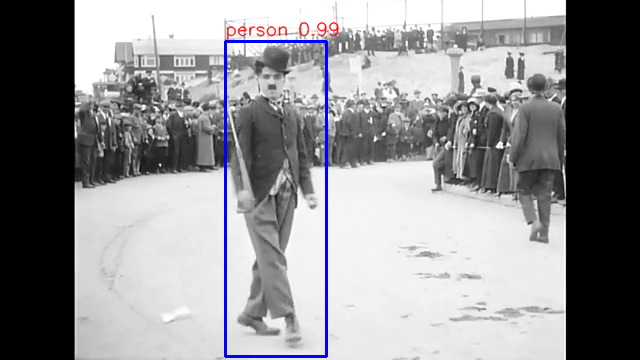

time: 1.43s
class: person, score: 0.99
box coordinate x,y,w,h: [225.14965057  40.68717957 100.654459   315.54978848]



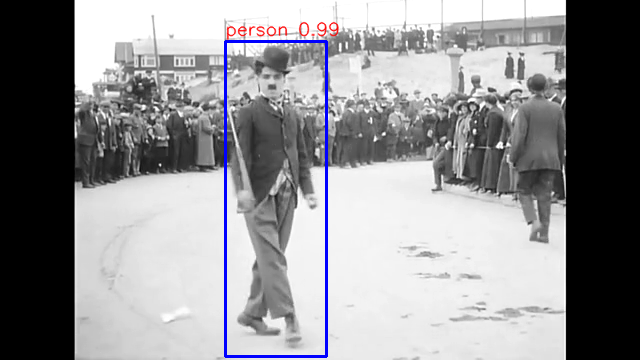

time: 1.53s
class: person, score: 0.98
box coordinate x,y,w,h: [223.17672729  29.38818097  97.72397995 336.63124323]



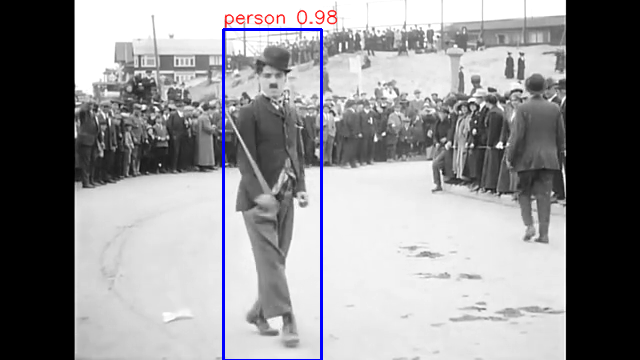

time: 1.47s
class: person, score: 0.97
box coordinate x,y,w,h: [219.69608307  46.9609952  103.03582191 306.27822876]



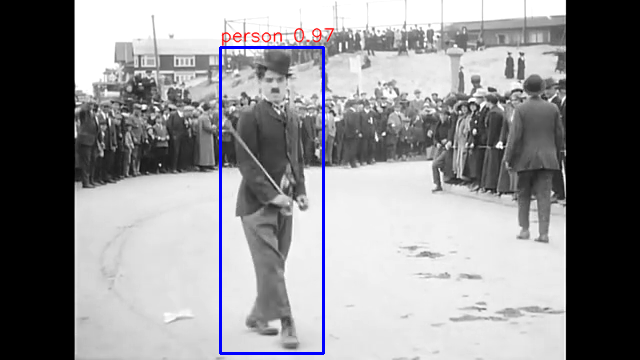

time: 1.52s
class: person, score: 0.93
box coordinate x,y,w,h: [234.16700363  15.63009024  83.72875214 370.02300739]



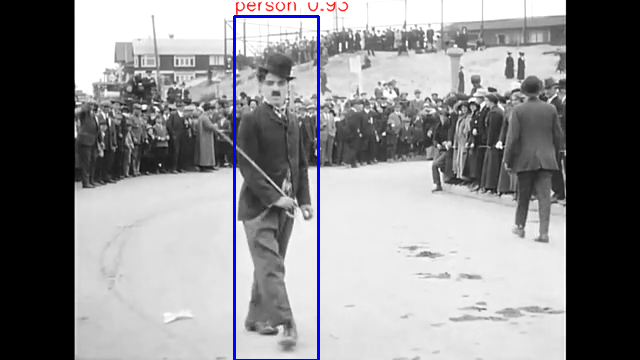

time: 1.51s
class: person, score: 0.93
box coordinate x,y,w,h: [234.24455643  15.69182396  83.61147881 369.87130165]



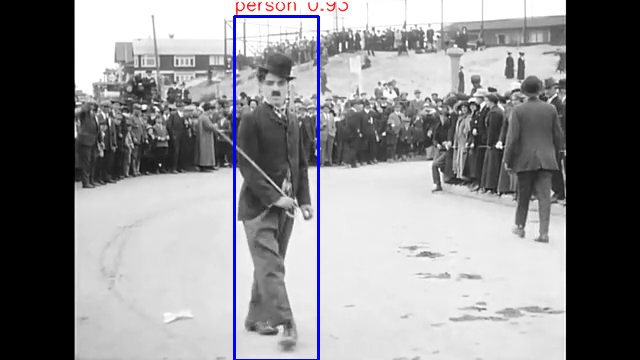

time: 1.53s
class: person, score: 0.98
box coordinate x,y,w,h: [221.84049606  48.52745891 105.93490601 303.11826468]



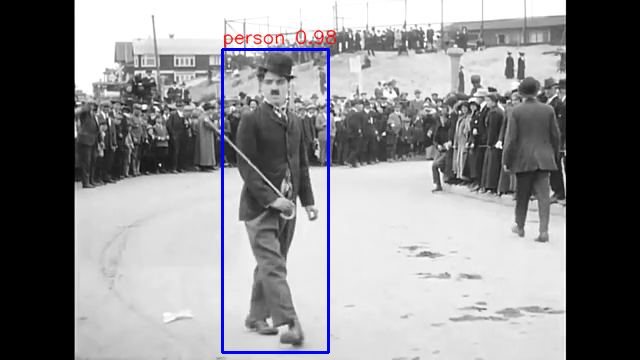

time: 1.36s
class: person, score: 0.97
box coordinate x,y,w,h: [221.72332764  47.76764274 106.19073868 304.47305918]



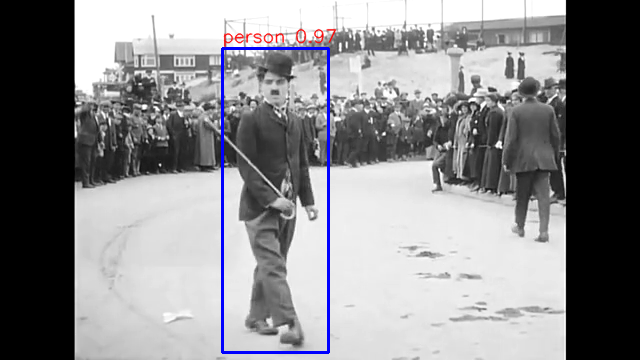

time: 1.46s
class: person, score: 0.99
box coordinate x,y,w,h: [223.02370071  44.75932002 105.74606895 314.0970397 ]



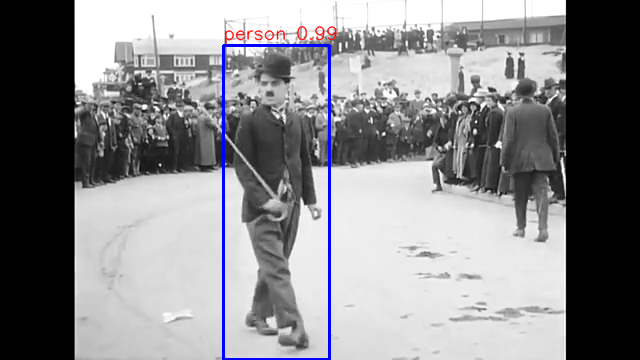

time: 1.39s
class: person, score: 0.99
box coordinate x,y,w,h: [224.73779678  47.2970438  104.21128273 312.29942322]
class: person, score: 0.79
box coordinate x,y,w,h: [489.89192963  84.973948    73.99903297 145.91474533]



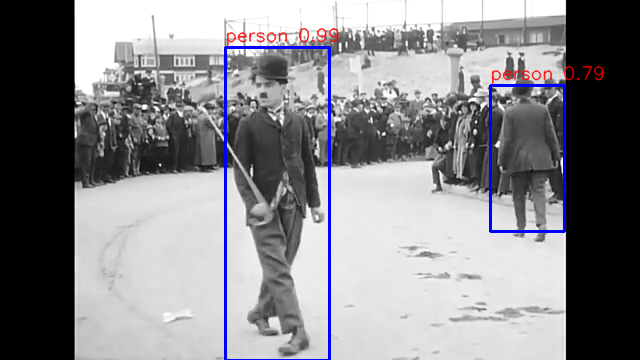

time: 1.18s
class: person, score: 0.99
box coordinate x,y,w,h: [224.76909637  47.38826036 104.21203613 312.40825653]
class: person, score: 0.81
box coordinate x,y,w,h: [489.9471283   84.78166044  73.84823322 146.54861569]



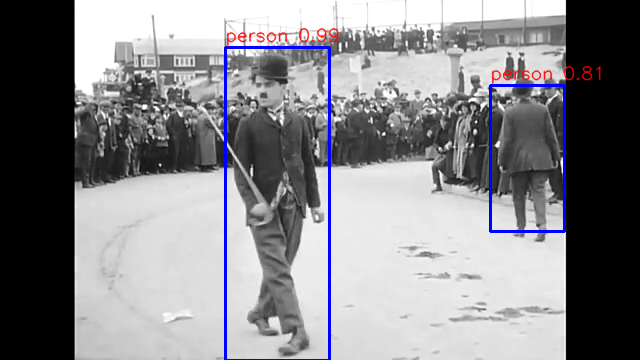

time: 1.47s
class: person, score: 1.00
box coordinate x,y,w,h: [227.5643158   33.90919447 105.68746567 333.96351814]
class: person, score: 0.77
box coordinate x,y,w,h: [490.08335114  83.54707181  72.74950981 146.43600583]



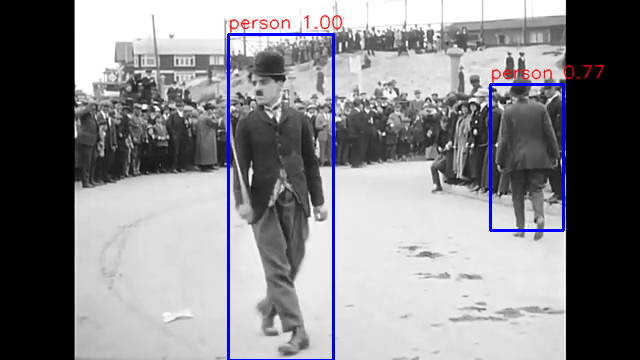

time: 1.42s
class: person, score: 0.99
box coordinate x,y,w,h: [224.67166901  40.34029484 110.77669144 323.15760612]
class: person, score: 0.84
box coordinate x,y,w,h: [488.7846756   85.52341461  74.06355858 141.94526911]



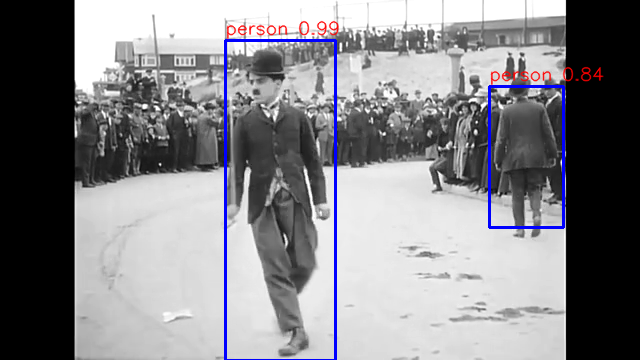

time: 1.31s
class: person, score: 0.99
box coordinate x,y,w,h: [224.49298859  40.75792551 110.92635155 322.6034832 ]
class: person, score: 0.84
box coordinate x,y,w,h: [488.79322052  85.55378258  74.09380913 141.95693135]



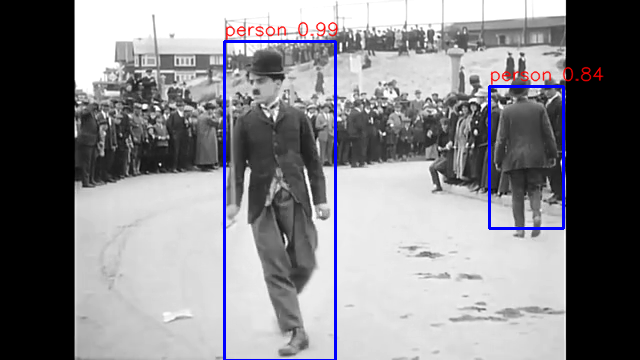

time: 1.50s
class: person, score: 1.00
box coordinate x,y,w,h: [209.40391541  42.583673   125.37675858 323.01933289]
class: person, score: 0.83
box coordinate x,y,w,h: [488.28468323  86.89412534  73.80065441 139.64177728]



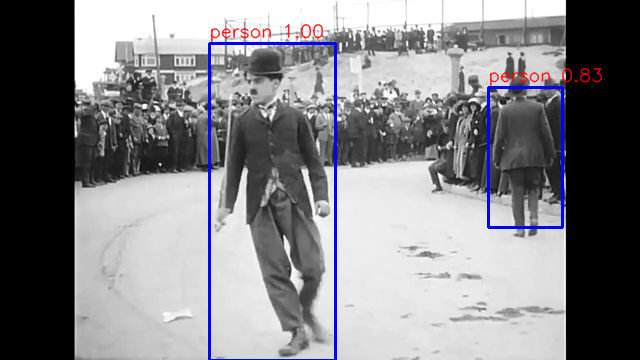

time: 1.41s
class: person, score: 1.00
box coordinate x,y,w,h: [209.95933533  43.01569104 125.12208939 322.61410475]
class: person, score: 0.83
box coordinate x,y,w,h: [488.5792923   86.57096744  73.48054886 140.32796144]



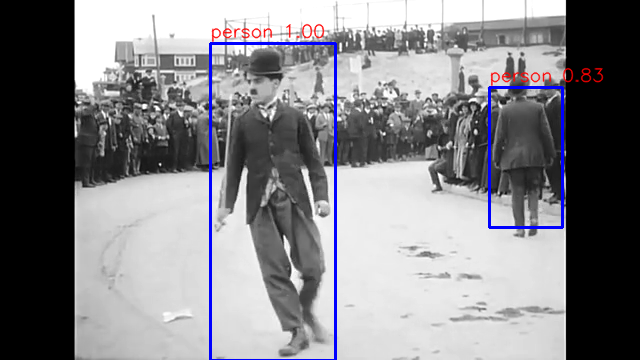

time: 1.58s
class: person, score: 1.00
box coordinate x,y,w,h: [205.05901337  41.71786666 132.56532669 323.05184126]
class: person, score: 0.87
box coordinate x,y,w,h: [489.72454071  87.71872222  71.67676926 139.34862256]



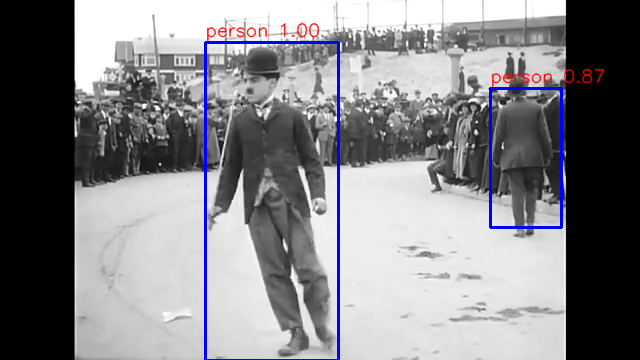

time: 1.46s
class: person, score: 1.00
box coordinate x,y,w,h: [202.06659317  34.43104506 130.1936245  334.98408794]
class: person, score: 0.83
box coordinate x,y,w,h: [486.79031372  84.90645289  73.22631836 146.11299276]



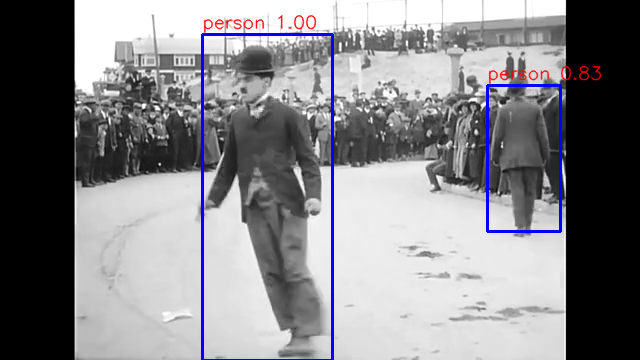

time: 1.53s
class: person, score: 1.00
box coordinate x,y,w,h: [192.91372299  26.84380531 124.10899162 340.64483643]
class: person, score: 0.86
box coordinate x,y,w,h: [486.12148285  88.70060384  75.95959187 137.65647054]



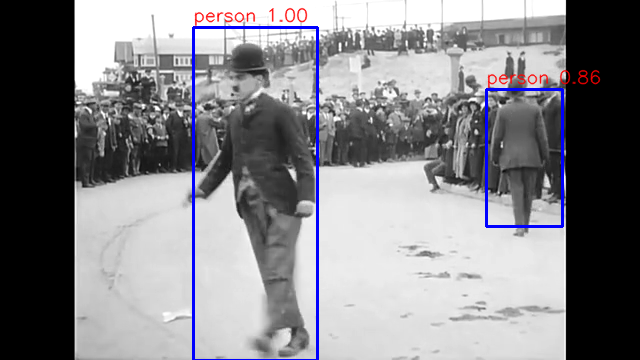

time: 1.49s
class: person, score: 1.00
box coordinate x,y,w,h: [192.59260178  26.86923265 124.48223114 340.48931122]
class: person, score: 0.86
box coordinate x,y,w,h: [486.23344421  88.73061776  75.82129955 137.58524179]



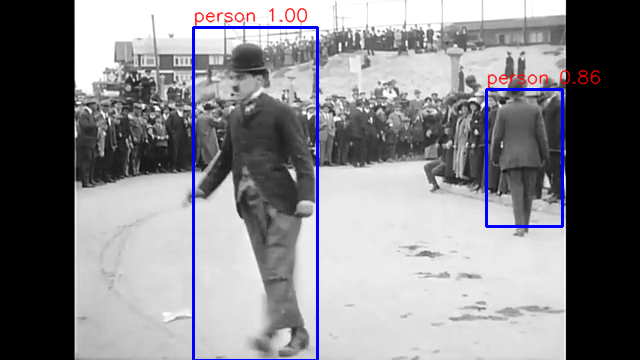

time: 1.42s
class: person, score: 1.00
box coordinate x,y,w,h: [192.38147736  26.40630484 124.86249924 341.35130882]
class: person, score: 0.86
box coordinate x,y,w,h: [486.14395142  88.8984865   75.87368965 137.38009572]



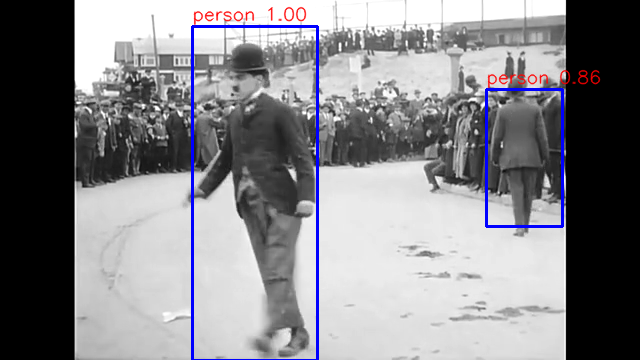

time: 1.47s
class: person, score: 1.00
box coordinate x,y,w,h: [183.94552231  28.31763625 137.4044323  345.43189287]
class: person, score: 0.79
box coordinate x,y,w,h: [486.92504883  87.05200553  73.42110634 139.44304705]
Finished detecting


In [ ]:
import sys
video = input("Enter file name :")
try:
  detect_video(video, yolo, all_classes)
except IndexError as e:
  print("Finished detecting")

In [ ]:
files.download("/content/drive/My Drive/YOLO_colab/detection_tracking/videos/res/"+"chaplin.mp4")
print("Done!!!")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Done!!!
